# Análisis exploratorio de datos

## Importar librerias

Importamos librerías que utilizaremos a lo largo del análisis:

In [3]:
import src.utils as utils

import os
import cv2 as cv
import matplotlib.pyplot as plt
import pandas as pd
import supervision as sv

from kaggle.api.kaggle_api_extended import KaggleApi

El primer paso es descargar el dataset, para analizarlo:

## Generar dataset

In [ ]:
download_path = '../data/plantvillage'
dataset_folder = os.path.join(download_path, 'plantvillage dataset')

# Si no existe la carpeta destino con el dataset, descargarlo
if not os.path.exists(dataset_folder):
    os.makedirs(download_path, exist_ok=True)

    api = KaggleApi()
    api.authenticate()

    api.dataset_download_files(
        'abdallahalidev/plantvillage-dataset',
        path=download_path,
        unzip=True
    )
    print("Dataset descargado y descomprimido.")
else:
    print("El dataset ya existe, no se descarga nada.")

El dataset ya existe, no se descarga nada.


Tenemos un dataset de imágenes de plantas que pueden estar sanas o enfermas. El dataset contiene imágenes de 14 especies de plantas, algunas con ciertas enfermedades, y otras con ejemplos de la planta únicamente sanas. Las imágenes están organizadas en carpetas por especie y enfermedad.

Podemos ver, además, que contamos con las mismas imágenes en 3 formatos, a color, en escala de grises, y con la planta segmentada (fondo negro). Pronto vamos a confirmar si se trata efectivamente de las mismas y la misma cantidad de imágenes, lo que nos puede permitir simplificar algunos análisis de los datos.

Como primer paso, recorremos todas las subcarpetas del dataset y generamos un `DataFrame` con las siguientes features:

- **Format**: indica el formato de la imagen. Puede tomar uno de los siguientes valores:
  - `'color'`
  - `'grayscale'`
  - `'segmented'`

- **Species**: especie de la planta.

- **Healthy** *(booleano)*: indica si la planta está sana (`True`) o no (`False`).

- **Disease**: nombre de la enfermedad en caso de que la planta no esté sana.

- **FileName**: nombre del archivo de imagen correspondiente.

In [ ]:
base_dir = '../data/plantvillage/plantvillage dataset'
subfolders = ['color', 'grayscale', 'segmented']
data = []

for sub in subfolders:
    sub_path = os.path.join(base_dir, sub)
    if not os.path.exists(sub_path):
        continue
    for folder in os.listdir(sub_path):
        folder_path = os.path.join(sub_path, folder)
        if not os.path.isdir(folder_path):
            continue
        species, disease = folder.split('___', 1)
        if disease == 'healthy':
            healthy = True
            disease = None
        else:
            healthy = False
        for file in os.listdir(folder_path):
            file_path = os.path.join(folder_path, file)
            if os.path.isfile(file_path):
                data.append({
                    'Format': sub,
                    'Species': species,
                    'Healthy': healthy,
                    'Disease': disease,
                    'FileName': file
                })

df = pd.DataFrame(data)

## Analisis del dataset

In [ ]:
df

,Format,Species,Healthy,Disease,FileName
0,color,Strawberry,True,None,8f558908-aa1b-4a86-855a-5094c2392e5a___RS_HL 1...
1,color,Strawberry,True,None,b8e9ed27-8e37-4214-9206-f8c0ef21cf4d___RS_HL 4...
2,color,Strawberry,True,None,abdd34a0-ab02-41e0-95a3-a014ab863ec2___RS_HL 1...
3,color,Strawberry,True,None,d1aee44a-b6bb-45b9-b7b6-5d553add8fd1___RS_HL 2...
4,color,Strawberry,True,None,3d28c3ea-8419-4e09-addd-211e3828e39f___RS_HL 1...
...,...,...,...,...,...
162911,segmented,Soybean,True,None,f6579a78-e6eb-4a65-82f7-7be30f100a07___RS_HL 5...
162912,segmented,Soybean,True,None,356eb227-3e6d-4164-b84d-31f590293644___RS_HL 4...
162913,segmented,Soybean,True,None,5d3def53-fdb2-4106-ad31-c020e75bccea___RS_HL 7...
162914,segmented,Soybean,True,None,63d474df-5512-4ecc-9cd3-c0649c260668___RS_HL 7...


Por la distribución del dataframe por 'Format' podemos ir suponiendo que efectivamente tenemos las mismas imágenes disponibles en los 3 formatos. Vamos a explorar algunas caracterísitcas más del dataset.

In [ ]:
df.describe()

,Format,Species,Healthy,Disease,FileName
count,162916,162916,162916,117664,162916
unique,3,14,2,20,108611
top,segmented,Tomato,False,Haunglongbing_(Citrus_greening),8f558908-aa1b-4a86-855a-5094c2392e5a___RS_HL 1...
freq,54306,54480,117664,16521,2


In [ ]:
df['Disease'].unique()

array([None, 'Black_rot', 'Early_blight', 'Target_Spot', 'Late_blight',
       'Tomato_mosaic_virus', 'Haunglongbing_(Citrus_greening)',
       'Leaf_Mold', 'Leaf_blight_(Isariopsis_Leaf_Spot)',
       'Powdery_mildew', 'Cedar_apple_rust', 'Bacterial_spot',
       'Common_rust_', 'Esca_(Black_Measles)',
       'Tomato_Yellow_Leaf_Curl_Virus', 'Apple_scab',
       'Northern_Leaf_Blight', 'Spider_mites Two-spotted_spider_mite',
       'Septoria_leaf_spot', 'Cercospora_leaf_spot Gray_leaf_spot',
       'Leaf_scorch'], dtype=object)

In [ ]:
df['Species'].unique()

array(['Strawberry', 'Grape', 'Potato', 'Blueberry', 'Corn_(maize)',
       'Tomato', 'Peach', 'Pepper,_bell', 'Orange',
       'Cherry_(including_sour)', 'Apple', 'Raspberry', 'Squash',
       'Soybean'], dtype=object)

Teniendo ya la lista de especies y de enfermedades (clases) disponibles, armamos unos mapas para usar como traductores en el resto del análisis.

Traducción de las especies:

* Apple: Manzana
* Blueberry: Arándano
* Cherry: Cereza
* Corn: Maíz
* Grape: Uva
* Peach: Durazno
* Pepper: Pimiento
* Potato: Papa
* Raspberry: Frambuesa
* Soybean: Soja
* Strawberry: Fresa
* Tomato: Tomate

Traducción de las enfermedades:

* scab: sarna
* black rot: podredumbre negra
* cedar apple rust: roya del manzano y cedro (hinchazón color rojizo a naranja producida por un hongo)
* powdery mildew: oídio (cenicilla o polvillo blanco - enfermedad fúngica)
* cercospora leaf spot / gray leaf spot: mancha foliar por cercospora / mancha foliar gris
* common rust: roya común
* northern leaf blight: tizón foliar del norte
* esca (black measles): esca (manchas negras)
* leaf blight (Isariopsis leaf spot): tizón de la hoja (mancha foliar por Isariopsis)
* Haunglongbing (HLB) / citrus greening: Huanglongbing (HLB) / enverdecimiento de los cítricos
* bacterial spot: mancha bacteriana
* early blight: tizón temprano
* late blight: tizón tardío
* leaf scorch: quemadura de la hoja
* bacterial spot: mancha bacteriana
* leaf mold: moho de la hoja
* septoria leaf spot: mancha foliar por septoria
* spider mites two-spotted spider mite: ácaros araña de dos manchas
* target spot: mancha diana
* mosaic virus: virus del mosaico
* yellow leaf curl virus: virus del rizado amarillo de la hoja

In [ ]:
# Species mapping
species_es_map = {
    'Strawberry': 'Fresa',
    'Grape': 'Uva',
    'Potato': 'Papa',
    'Blueberry': 'Arándano',
    'Corn_(maize)': 'Maíz',
    'Tomato': 'Tomate',
    'Peach': 'Durazno',
    'Pepper,_bell': 'Pimiento',
    'Orange': 'Naranja',
    'Cherry_(including_sour)': 'Cereza',
    'Apple': 'Manzana',
    'Raspberry': 'Frambuesa',
    'Squash': 'Calabaza',
    'Soybean': 'Soja'
}

# Disease mapping
disease_es_map = {
    'Black_rot': 'Podredumbre negra',
    'Early_blight': 'Tizón temprano',
    'Target_Spot': 'Mancha diana',
    'Late_blight': 'Tizón tardío',
    'Tomato_mosaic_virus': 'Virus del mosaico',
    'Haunglongbing_(Citrus_greening)': 'Huanglongbing (HLB) / enverdecimiento de los cítricos',
    'Leaf_Mold': 'Moho de la hoja',
    'Leaf_blight_(Isariopsis_Leaf_Spot)': 'Tizón de la hoja (mancha foliar por Isariopsis)',
    'Powdery_mildew': 'Oídio (cenicilla o polvillo blanco)',
    'Cedar_apple_rust': 'Roya del manzano y cedro',
    'Bacterial_spot': 'Mancha bacteriana',
    'Common_rust_': 'Roya común',
    'Esca_(Black_Measles)': 'Esca (manchas negras)',
    'Tomato_Yellow_Leaf_Curl_Virus': 'Virus del rizado amarillo de la hoja',
    'Apple_scab': 'Sarna',
    'Northern_Leaf_Blight': 'Tizón foliar del norte',
    'Spider_mites Two-spotted_spider_mite': 'Ácaros araña de dos manchas',
    'Septoria_leaf_spot': 'Mancha foliar por septoria',
    'Cercospora_leaf_spot Gray_leaf_spot': 'Mancha foliar por cercospora / mancha foliar gris',
    'Leaf_scorch': 'Quemadura de la hoja'
}

Y agregamos las columnas en español al dataset:

In [ ]:
# Add Spanish species names
df['Especie'] = df['Species'].map(species_es_map)

# Add Spanish disease names, use 'Sano' for healthy samples
df['Enfermedad'] = df.apply(
    lambda row: 'Sano' if row['Healthy'] else disease_es_map.get(row['Disease'], row['Disease']),
    axis=1
)

Repasamos en detalle las clases por especie y especies por clase con las que contamos en el dataset:

Clases disponibles por especie:

* Apple:
    * healthy
    * scab
    * black rot
    * cedar apple rust
* Blueberry:
    * healthy
* Cherry:
    * healthy
    * powdery mildew
* Corn:
    * healthy
    * cercospora leaf spot / gray leaf spot
    * common rust
    * northern leaf blight
* Grape:
    * healthy
    * black rot
    * esca (black measles)
    * leaf blight (Isariopsis leaf spot)
* Orange:
    * Haunglongbing (HLB) / citrus greening
* Peach:
    * healthy
    * bacterial spot
* Pepper:
    * healthy
    * bacterial spot
* Potato:
    * healthy
    * early blight
    * late blight
* Raspberry:
    * healthy
* Soybean:
    * healthy
* Squash:
    * healthy
* Strawberry:
    * healthy
    * leaf scorch
* Tomato:
    * healthy
    * bacterial spot
    * early blight
    * late blight
    * leaf mold
    * septoria leaf spot
    * spider mites two-spotted spider mite
    * target spot
    * mosaic virus
    * yellow leaf curl virus

Plantas disponibles por clase:

* healthy: Apple, Blueberry, Cherry, Corn, Grape, Peach, Pepper, Potato, Raspberry, Soybean, Strawberry, Tomato
* scab: Apple
* black rot: Apple, Grape
* cedar apple rust: Apple
* powdery mildew: Cherry
* cercospora leaf spot / gray leaf spot: Corn
* common rust: Corn
* northern leaf blight: Corn
* esca (black measles): Grape
* leaf blight (Isariopsis leaf spot): Grape
* Haunglongbing (HLB) / citrus greening: Orange
* bacterial spot: Peach, Pepper, Tomato
* early blight: Potato, Tomato
* late blight: Potato, Tomato
* leaf scorch: Strawberry
* bacterial spot: Tomato
* leaf mold: Tomato
* septoria leaf spot: Tomato
* spider mites two-spotted spider mite: Tomato
* target spot: Tomato
* mosaic virus: Tomato
* yellow leaf curl virus: Tomato

## Graficamos la distribución de clases, total y por especies:

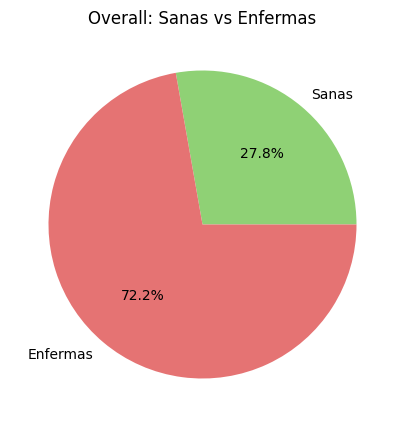

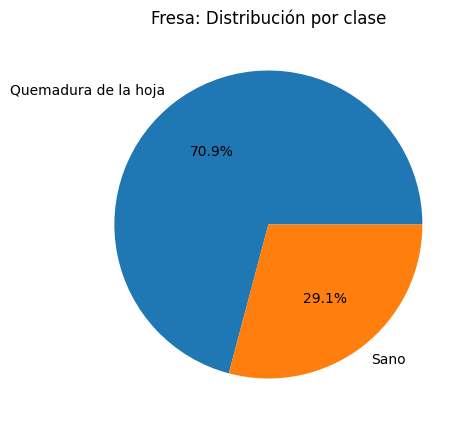

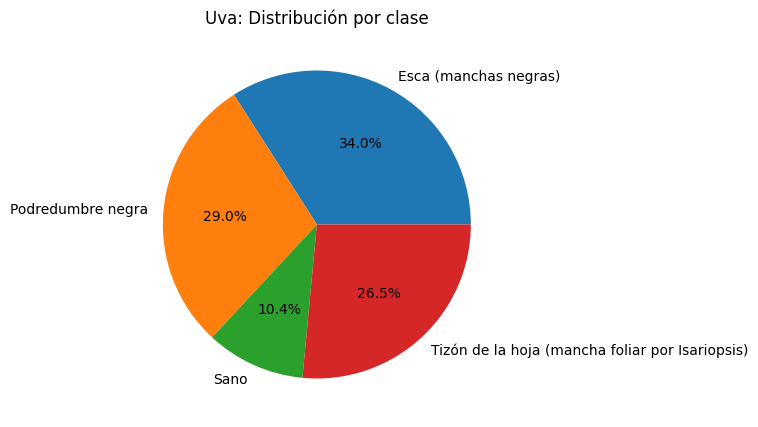

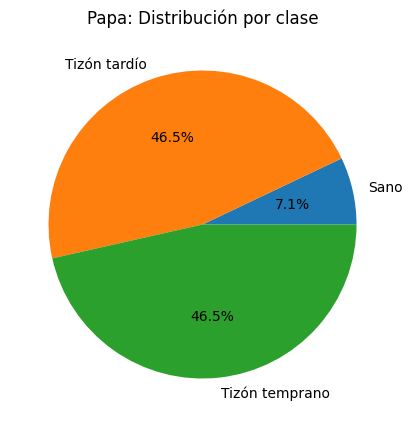

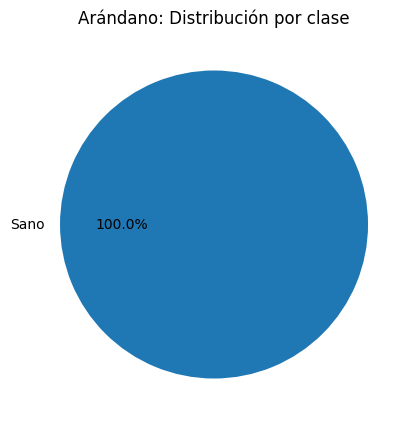

...

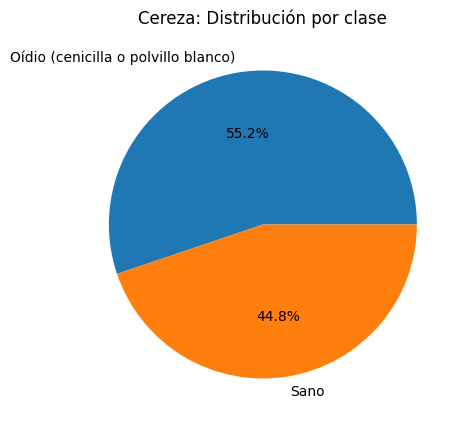

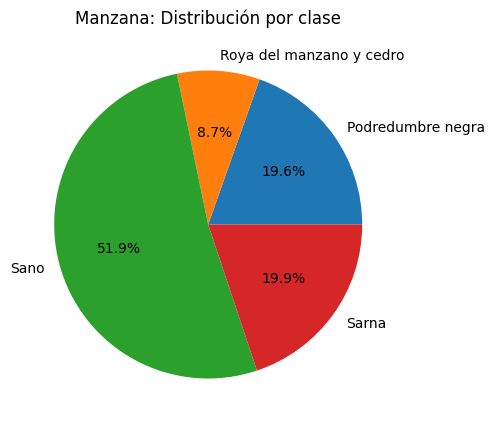

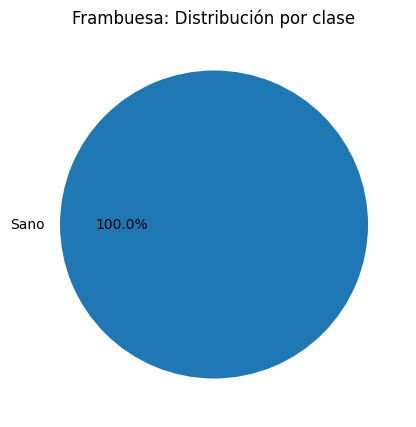

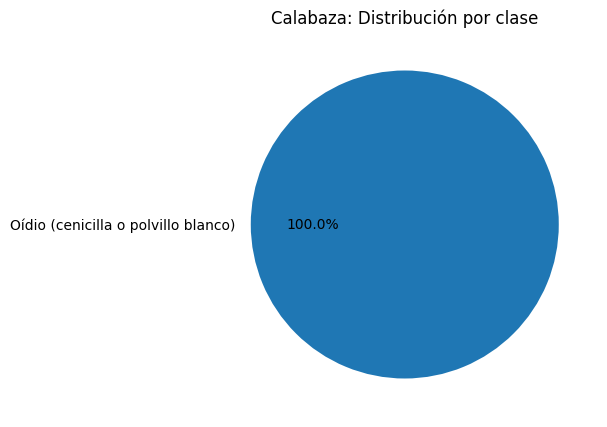

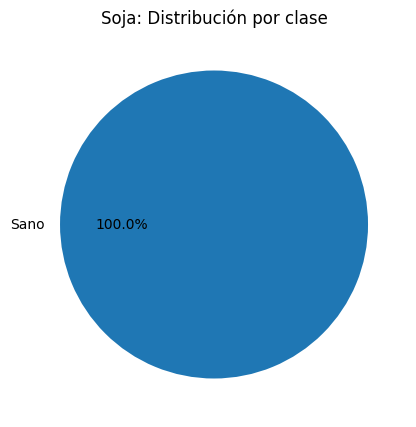

In [ ]:
# Analizamos solo color para reducir el procesamiento
df_color = df[df['Format'] == 'color']

# Overall healthy vs diseased
healthy_count = df_color['Healthy'].sum()
diseased_count = (~df_color['Healthy']).sum()

plt.figure(figsize=(5, 5))
plt.pie([healthy_count, diseased_count], labels=['Sanas', 'Enfermas'], autopct='%1.1f%%', colors=['#8fd175', '#e57373'])
plt.title('Overall: Sanas vs Enfermas')
plt.show()

# Get all possible classes (in Spanish)
all_classes = sorted(df_color['Enfermedad'].unique())

# Per species: pie chart of healthy and each disease, always showing all classes
species_list = df_color['Especie'].unique()
for species in species_list:
    subset = df_color[df_color['Especie'] == species]
    counts = subset['Enfermedad'].value_counts().reindex(all_classes, fill_value=0)
    # Only plot classes present in this species (nonzero)
    present = counts[counts > 0]
    plt.figure(figsize=(5, 5))
    plt.pie(present, labels=present.index, autopct='%1.1f%%')
    plt.title(f'{species}: Distribución por clase')
    plt.show()

## Conclusion de los primeros datos:

## Conclusiones EDA – PlantVillage Dataset

### 1. Desbalance general de clases

- **El 72,2% de las imágenes corresponde a hojas enfermas** y solo el 27,8% a hojas sanas.
- Este desbalance puede sesgar a los modelos predictivos a favor de la clase mayoritaria (enfermas).
- **Recomendación:** aplicar estrategias de balanceo (oversampling/undersampling, ponderación de clases) y utilizar métricas robustas (F1, recall por clase, balanced accuracy), no solo accuracy.

---

### 2. Distribución de clases por especie

#### a. **Ejemplos de desbalance extremo**
- **Arándano (Blueberry):** 100% de las imágenes son sanas, por lo que no es útil para tareas de clasificación binaria o multiclase de enfermedades.
- **Durazno (Peach):** 86,5% presentan “mancha bacteriana”, solo 13,5% son sanas.
- **Fresa (Strawberry):** 70,9% presentan “quemadura de la hoja”, solo 29,1% sanas.

#### b. **Especies más balanceadas**
- **Maíz (Corn):** Distribución relativamente balanceada: 30,2% sanas, y el resto repartido entre tres enfermedades.
- **Papa (Potato):** 93% de las imágenes presentan “tizón temprano” o “tizón tardío”, solo 7,1% sanas.
- **Uva (Grape):** Ninguna enfermedad supera el 34%, pero solo el 10,4% son sanas.

#### c. **Alta diversidad de clases**
- **Tomate (Tomato):** 10 clases distintas de enfermedades, ninguna supera el 30%. La más frecuente es “virus del rizado amarillo de la hoja” (29,5%), seguido de “mancha bacteriana” (11,7%). Solo el 8,8% son sanas.

#### d. **Otras observaciones**
- Varias especies solo presentan imágenes sanas o una única enfermedad (por ejemplo: Blueberry, Raspberry, Squash, Soybean solo tienen sanas. Orange solo tiene “citrus greening”).

---

### 3. Cobertura y limitaciones del dataset

- Hay enfermedades que solo afectan a una especie y otras que aparecen en varias, pero con diferente representación.
- No todas las especies tienen ejemplos de hojas sanas y enfermas, lo que limita la evaluación en tareas multiclase o binarias.
- Algunas enfermedades tienen muy poca representación (por ejemplo, en tomate “virus del mosaico” solo 2,1%).

---

### 4. Implicancias para el modelado

- **Alta probabilidad de overfitting a clases mayoritarias:** si no se balancean las clases, el modelo tenderá a predecir la clase dominante.
- **Evaluación justa:** fundamental usar sets de validación estratificados y métricas por clase (matriz de confusión, recall por clase, macro-F1).
- **Posible necesidad de agrupar enfermedades poco frecuentes:** para especies con muchas clases poco representadas, se podría fusionar clases raras en una categoría “otras enfermedades” o ajustar la granularidad de salida según el caso de uso.

---

###  Resumen

> El dataset PlantVillage presenta un fuerte desbalance global y particularidades por especie, con coberturas de clase heterogéneas y casos extremos de escasez o ausencia de ejemplos de ciertas clases. Esto obliga a un diseño cuidadoso del pipeline de modelado, enfatizando el uso de métricas robustas, balanceo de clases y, si es necesario, reagrupamiento de clases poco representadas para lograr una clasificación confiable.



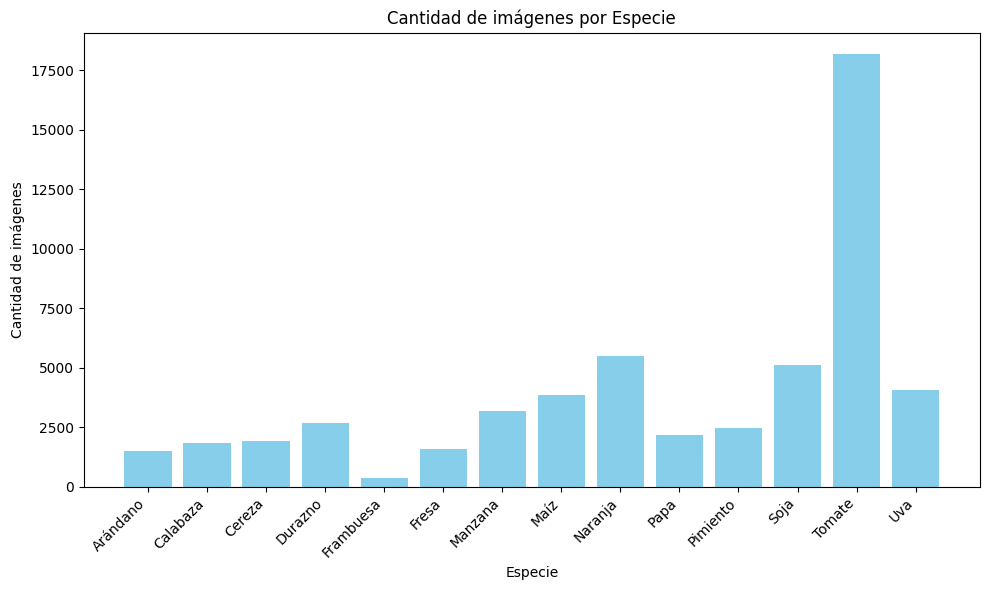

In [35]:
# Count samples per species
species_counts = df_color['Especie'].value_counts()

# Sort species alphabetically for consistent plotting, or by count if preferred
species_counts = species_counts.sort_index()

plt.figure(figsize=(10, 6))
plt.bar(species_counts.index, species_counts.values, color='skyblue')

plt.xlabel('Especie')
plt.ylabel('Cantidad de imágenes')
plt.title('Cantidad de imágenes por Especie')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

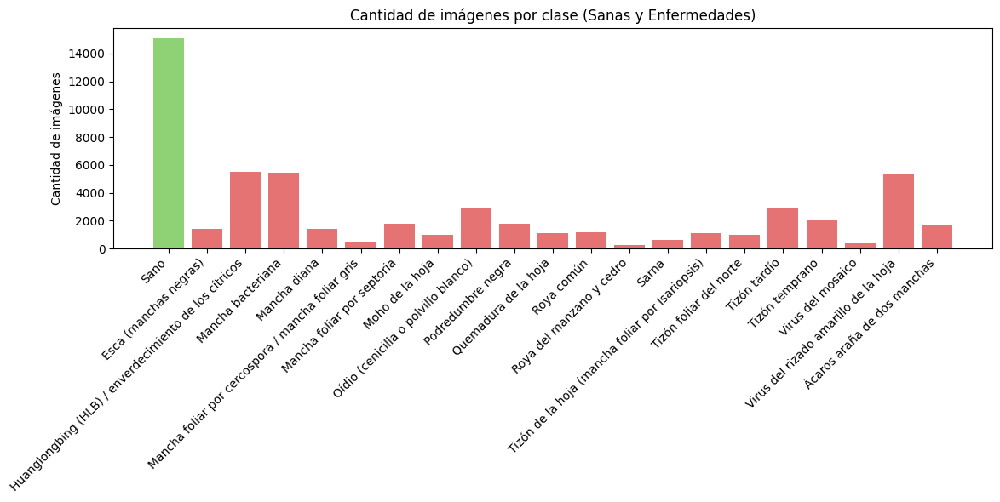

In [36]:
# Count samples per class (healthy and each disease)
counts = df_color['Enfermedad'].value_counts()
# Ensure "Sano" is first
counts = counts.sort_index()
if 'Sano' in counts.index:
    counts = counts.reindex(['Sano'] + [c for c in counts.index if c != 'Sano'])

plt.figure(figsize=(12, 6))
plt.bar(counts.index, counts.values, color=['#8fd175' if c == 'Sano' else '#e57373' for c in counts.index])
plt.xticks(rotation=45, ha='right')
plt.ylabel('Cantidad de imágenes')
plt.title('Cantidad de imágenes por clase (Sanas y Enfermedades)')
plt.tight_layout()
plt.show()

## Análisis de la Distribución de Imágenes por Especie y Clase

### 1. Distribución por especie

- Existe una **gran variabilidad en la cantidad de imágenes según la especie**.
- **Tomate** sobresale claramente como la especie con mayor representación, con más de 18.000 imágenes, lo que puede inducir a sesgos durante el entrenamiento de modelos si no se balancea apropiadamente.
- Otras especies con buena representación son **Soja, Naranja, Papa, Maíz y Uva**.
- Especies como **Frambuesa** y **Fresa** tienen un número considerablemente menor de imágenes, lo que podría dificultar la generalización del modelo para estas especies.
- La presencia desigual de imágenes por especie puede influir negativamente en la capacidad del modelo para reconocer enfermedades en especies menos representadas.

---

### 2. Distribución por clase (sano/enfermedad)

- **La clase “Sano” es la más frecuente a nivel individual**, superando ampliamente a cualquier clase de enfermedad específica.
- Algunas enfermedades como **“Mancha bacteriana”** y **“Virus del rizado amarillo de la hoja”** también tienen alta representación, pero ninguna se acerca al volumen de la clase “Sano”.
- Otras clases de enfermedad presentan una **frecuencia baja o muy baja** (por ejemplo, “Virus del mosaico”, “Sarna”, “Oídio”), lo que dificulta su detección por parte de un modelo estándar.
- La **desproporción entre clases** sugiere la necesidad de estrategias de balanceo de clases para evitar que el modelo priorice las clases más abundantes y subestime las menos frecuentes.
- Algunas clases aparecen solo en una o dos especies, acentuando el problema del desbalance, tanto a nivel global como dentro de cada especie.

---

### 3. Implicancias para el modelado

- El desbalance observado puede conducir a un **sesgo del modelo hacia especies y clases más representadas**.
- Es fundamental emplear técnicas de balanceo, como muestreo estratificado, ponderación de pérdidas (loss weighting) o data augmentation para clases minoritarias.
- Las métricas de evaluación deben considerar este desbalance, priorizando métricas por clase (macro F1, recall por clase, matriz de confusión).
- La baja representación de ciertas especies y enfermedades puede limitar la generalización del modelo y su utilidad práctica en escenarios reales.

---

> **En síntesis:**  
> La base de datos está dominada por unas pocas especies (principalmente tomate) y por la clase “sano”, mientras que muchas enfermedades y especies están subrepresentadas. Esto debe ser abordado explícitamente en el pipeline de modelado y validación para obtener un clasificador robusto y útil.


Manzana - Sano


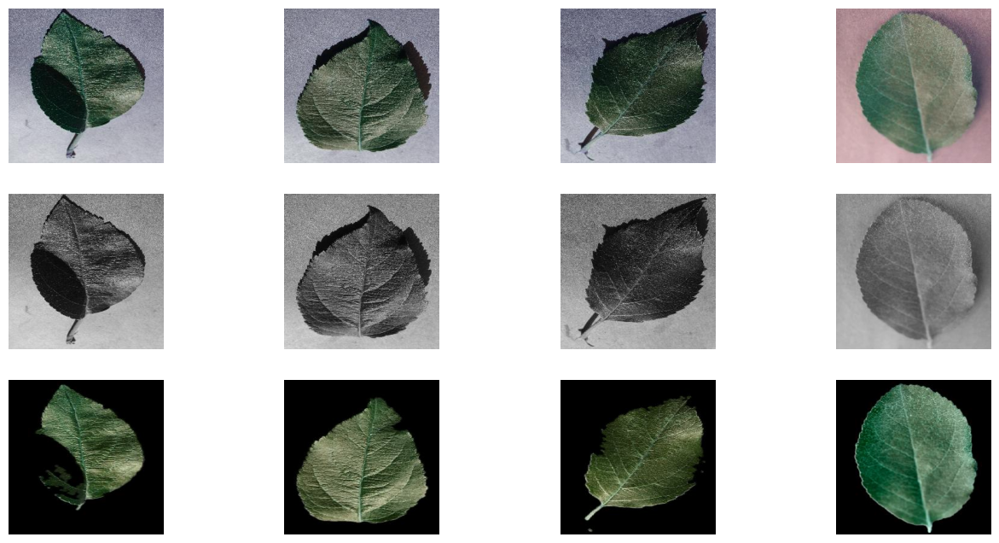

Manzana - Roya del manzano y cedro


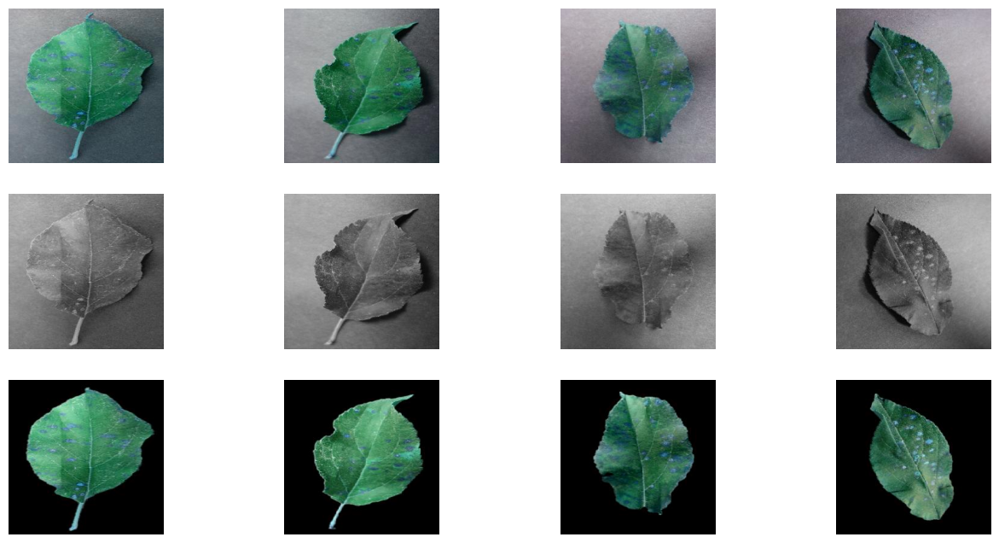

Manzana - Sarna


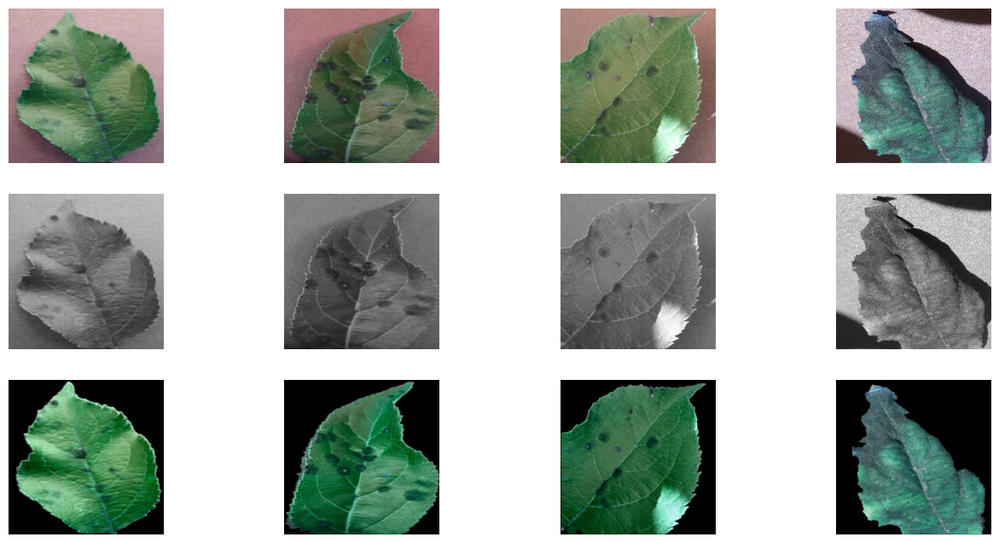

Manzana - Podredumbre negra


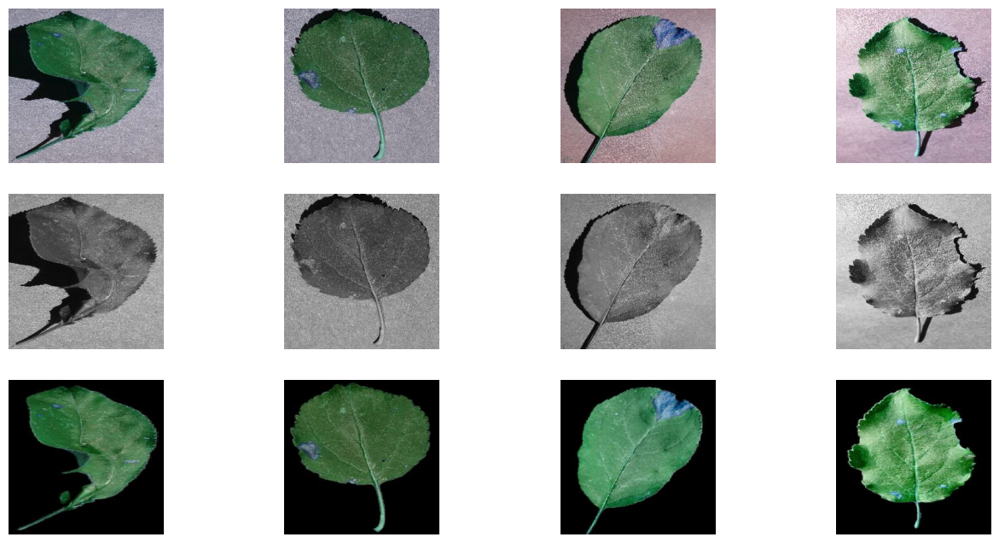

Arándano - Sano


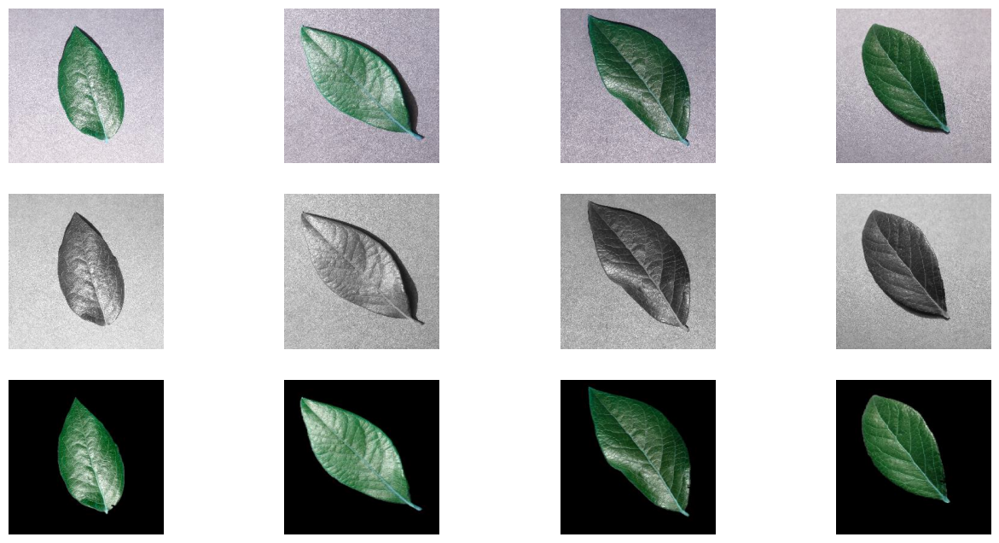

Cereza - Sano


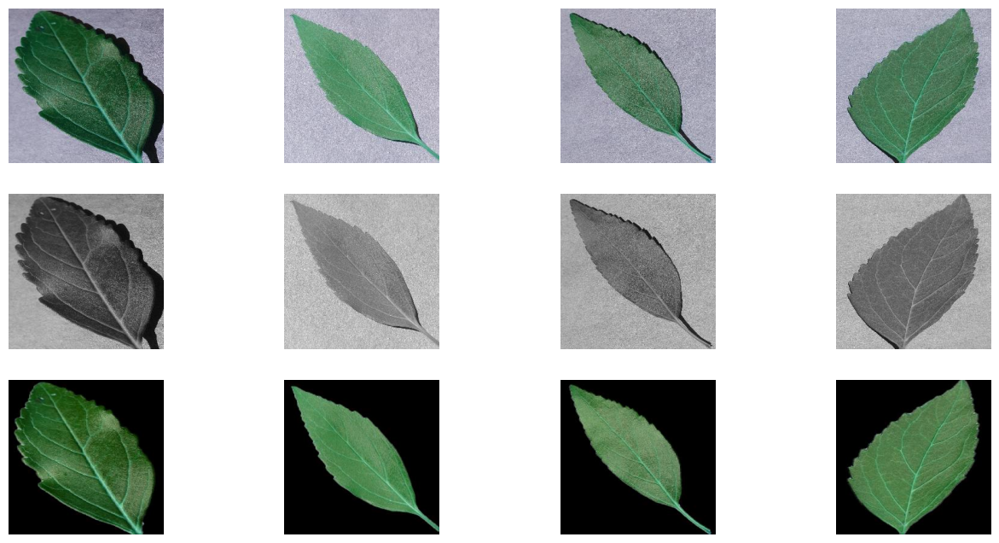

Cereza - Oídio (cenicilla o polvillo blanco)


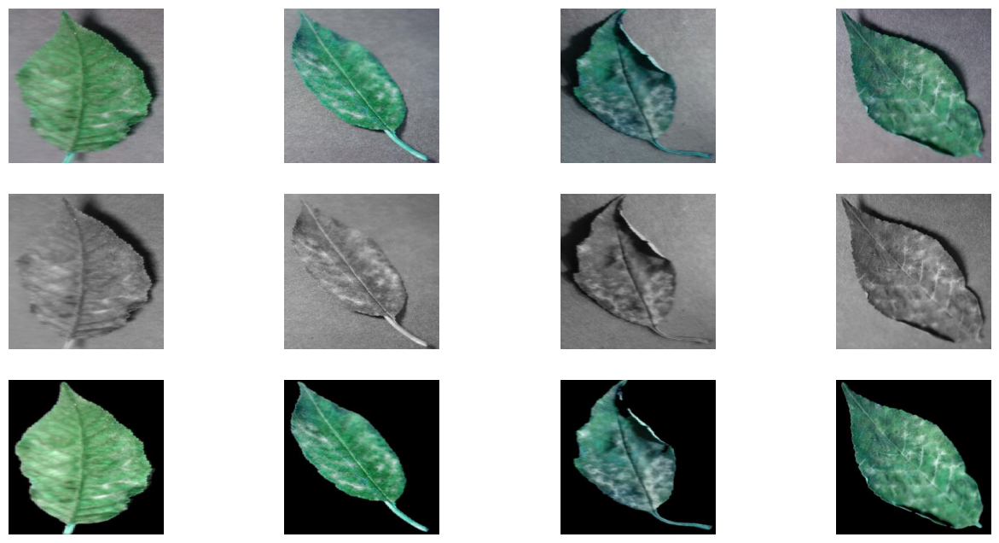

Maíz - Sano


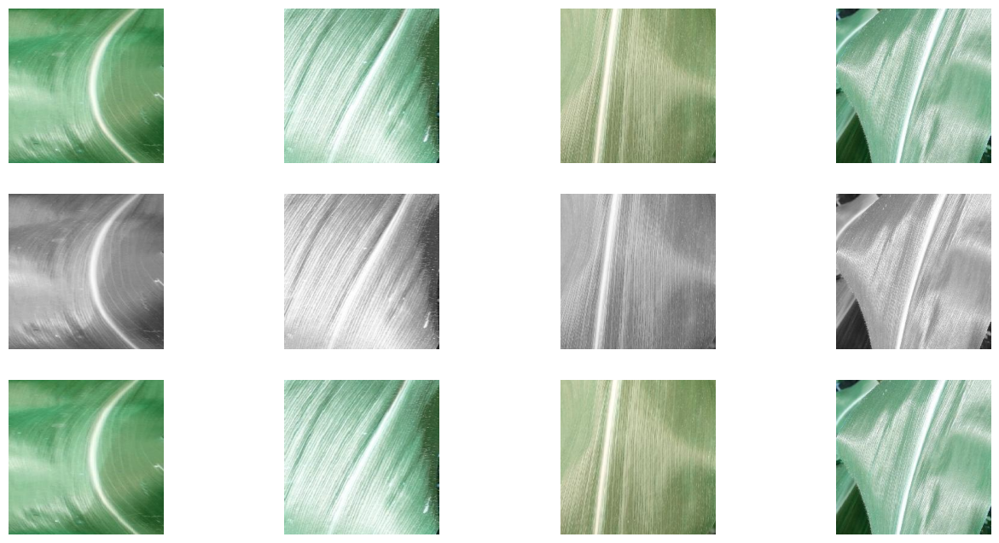

Maíz - Roya común


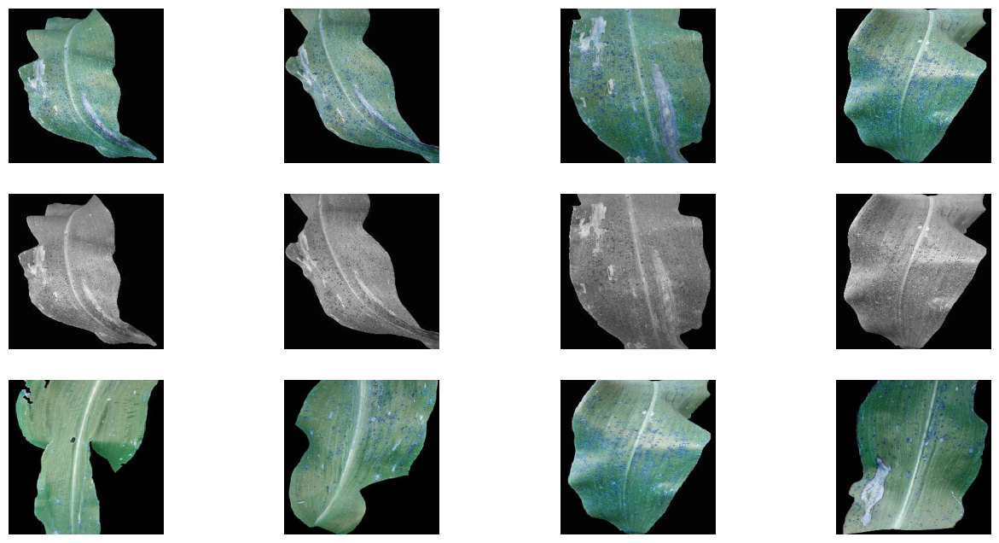

Maíz - Tizón foliar del norte


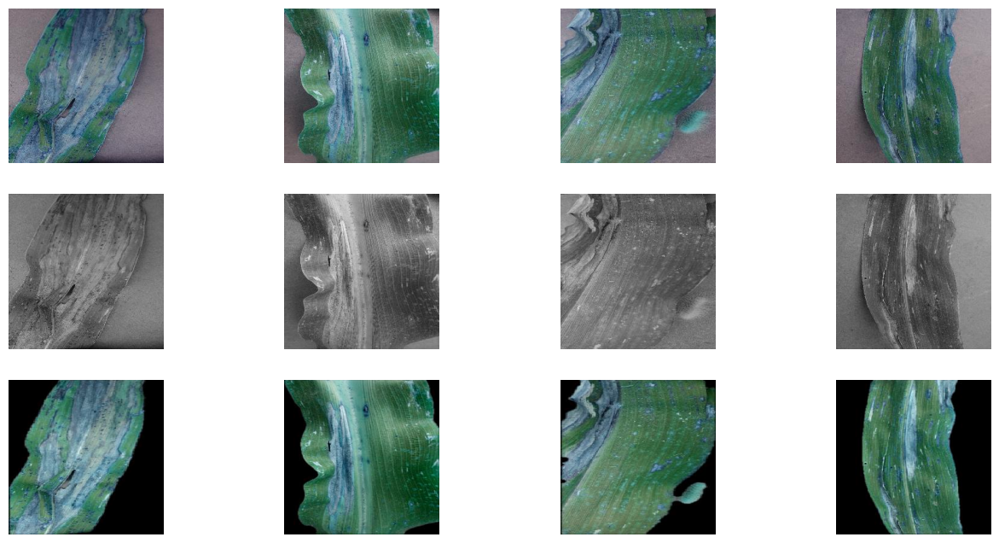

Maíz - Mancha foliar por cercospora / mancha foliar gris


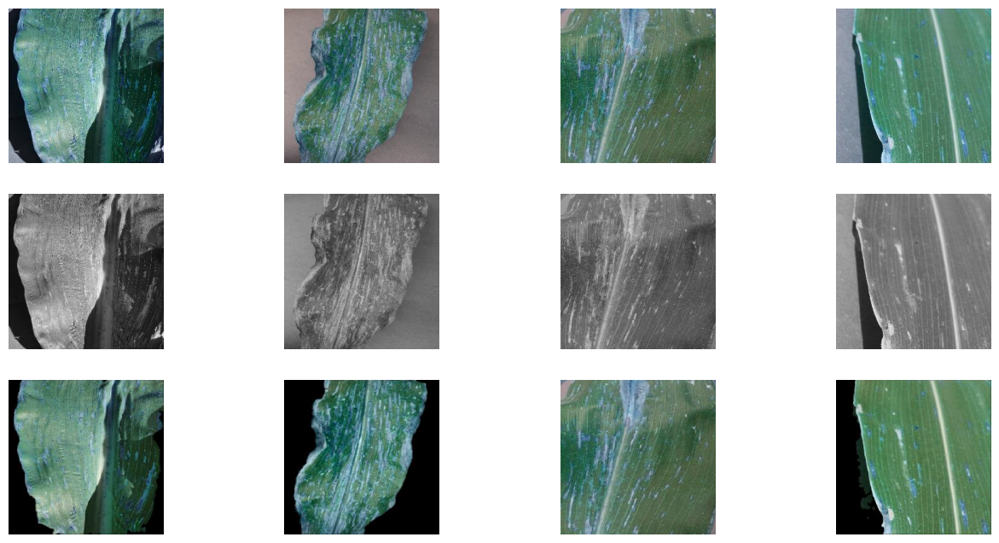

Uva - Sano


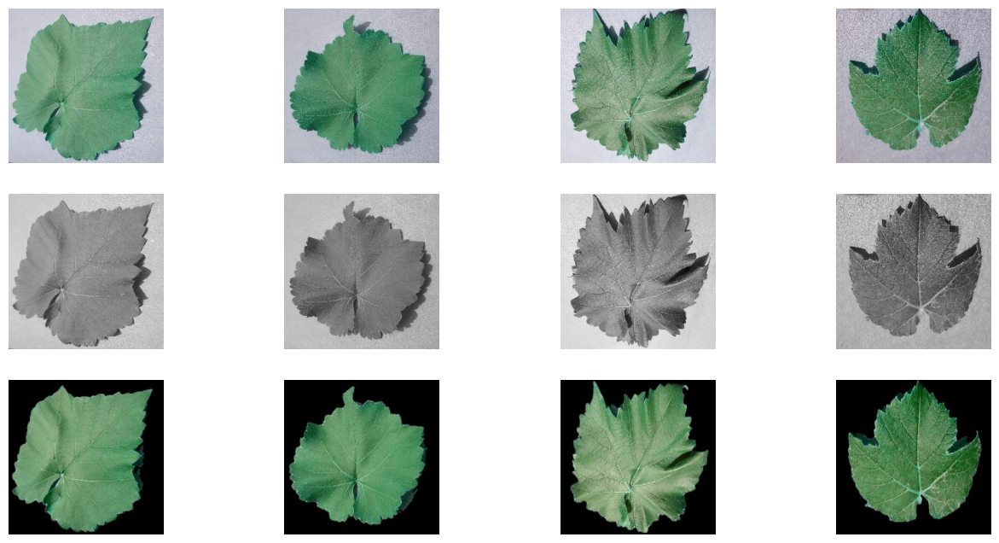

Uva - Podredumbre negra


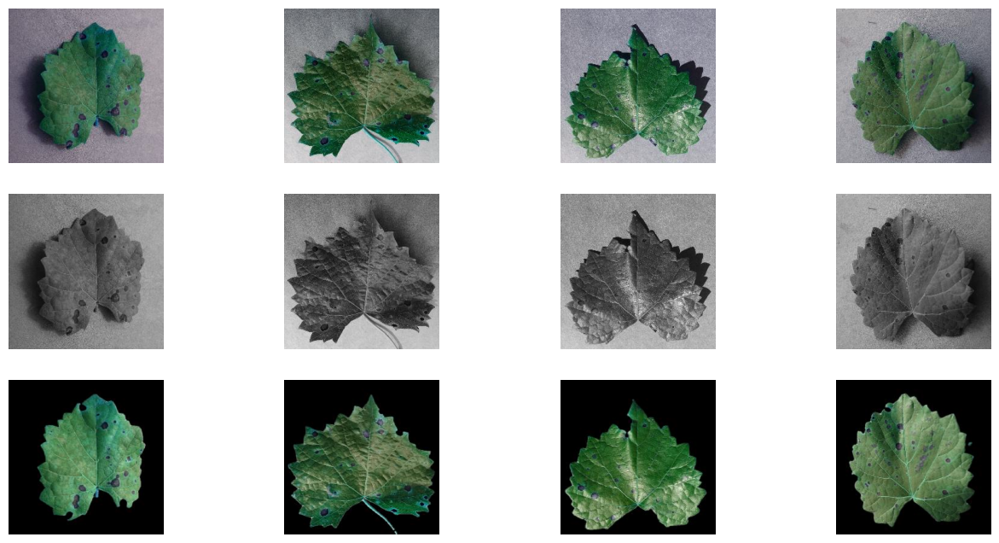

Uva - Tizón de la hoja (mancha foliar por Isariopsis)


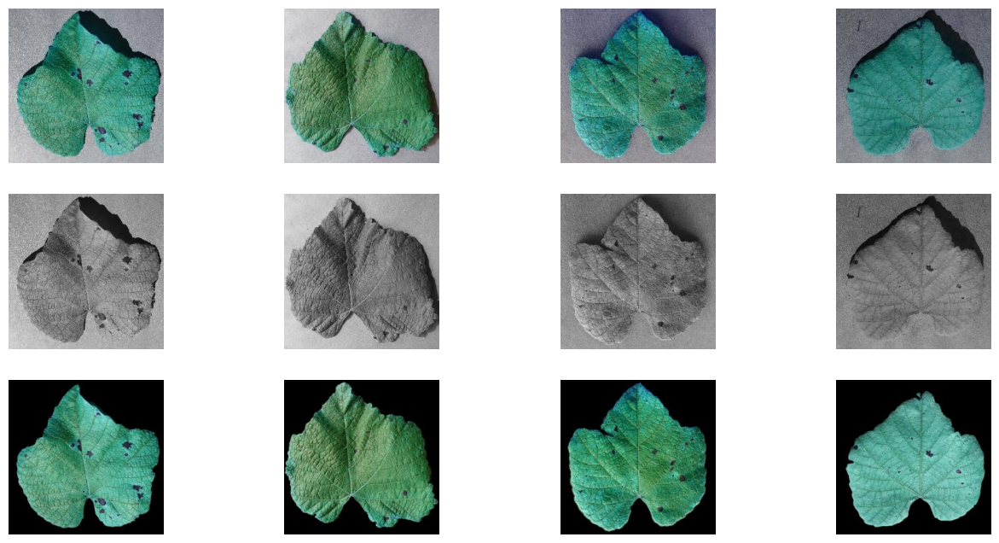

Uva - Esca (manchas negras)


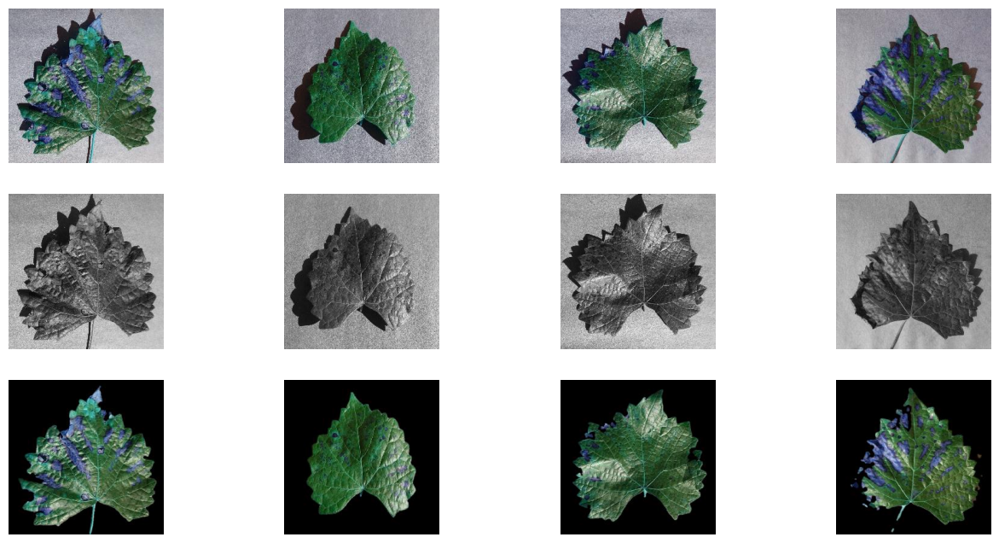

Naranja - Huanglongbing (HLB) / enverdecimiento de los cítricos


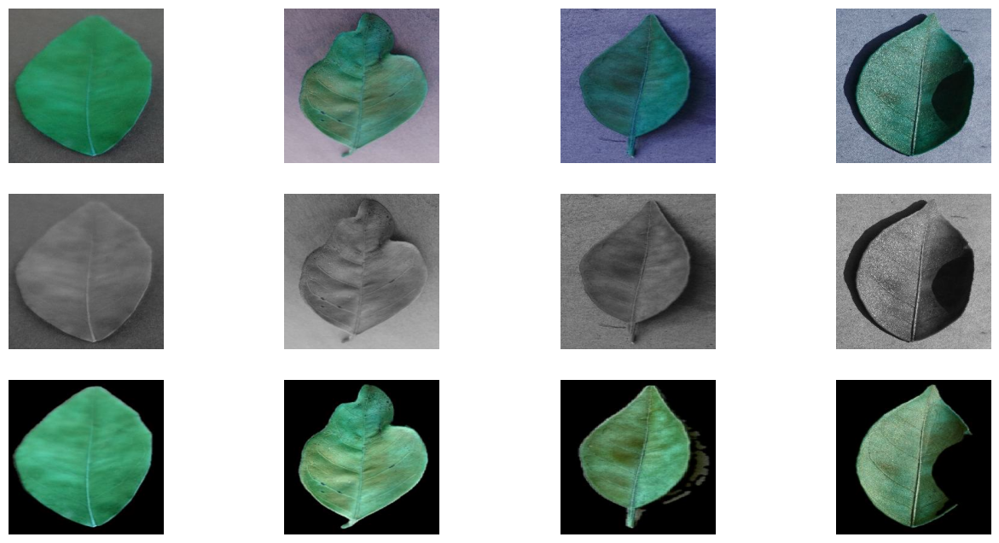

Durazno - Sano


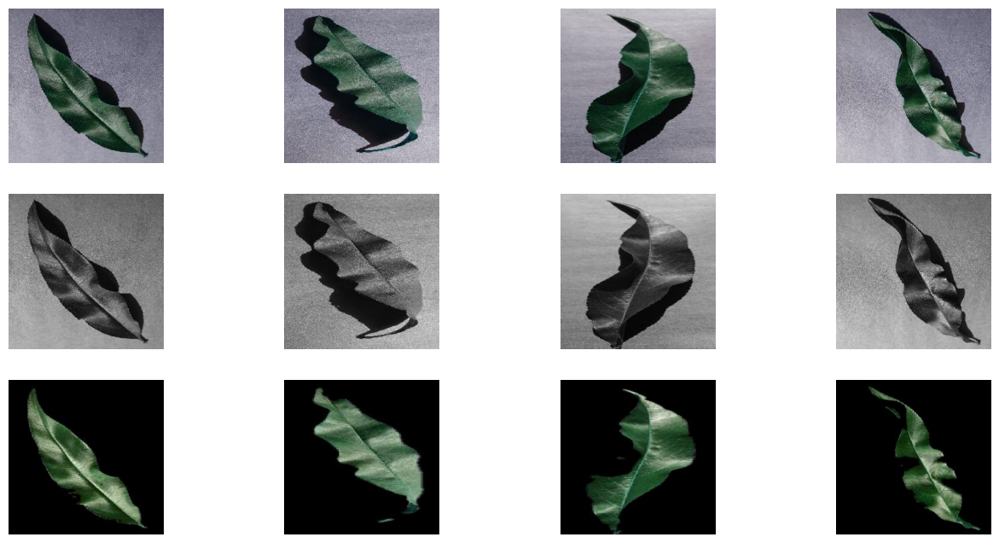

Durazno - Mancha bacteriana


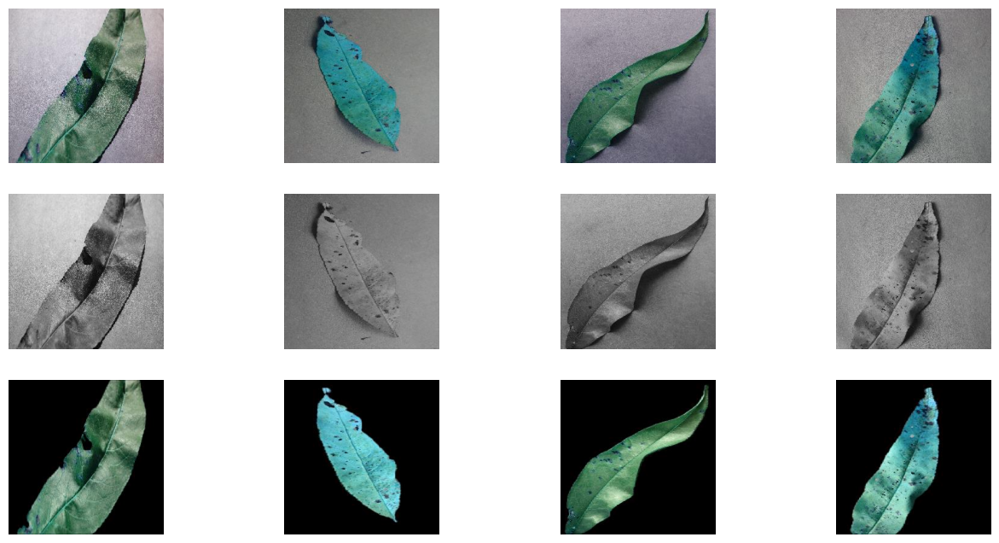

Pimiento - Sano


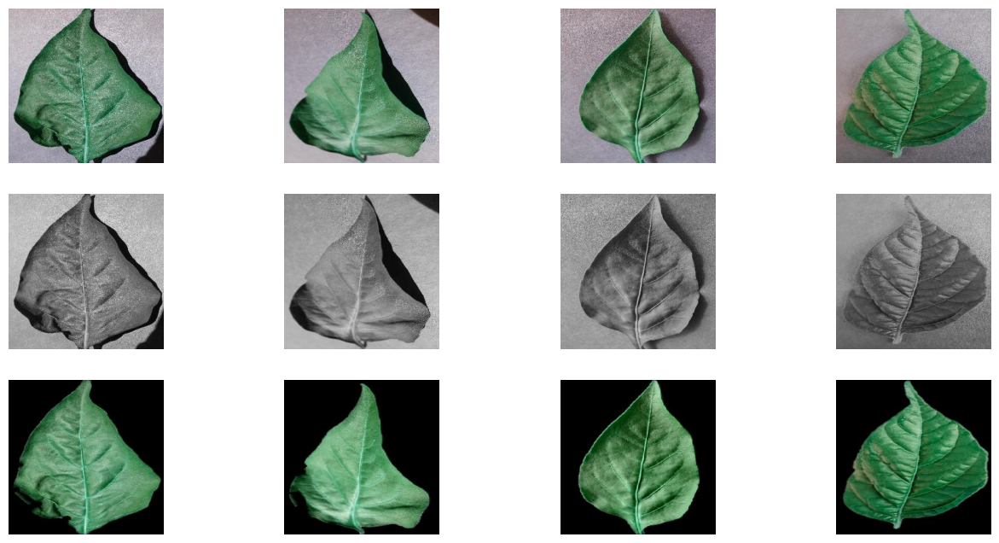

Pimiento - Mancha bacteriana


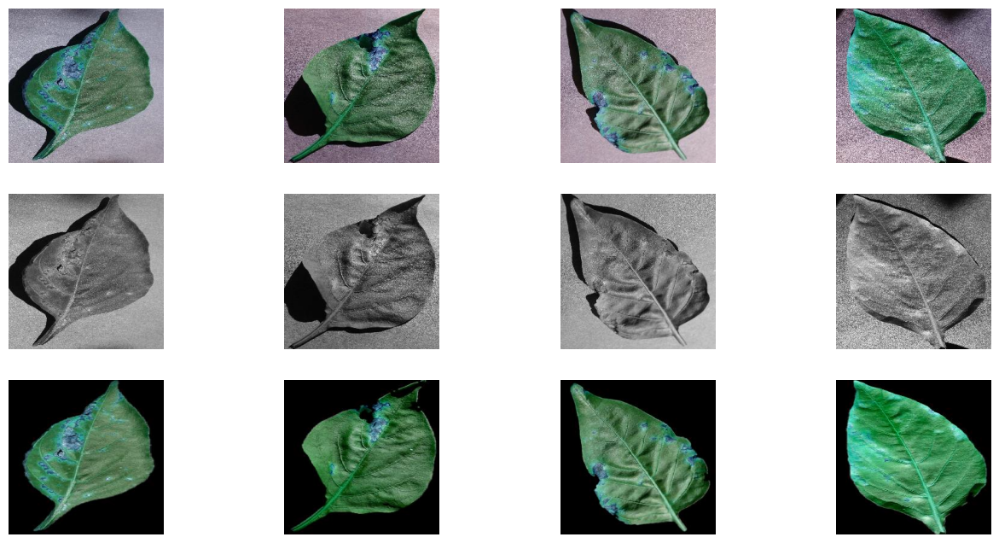

Papa - Sano


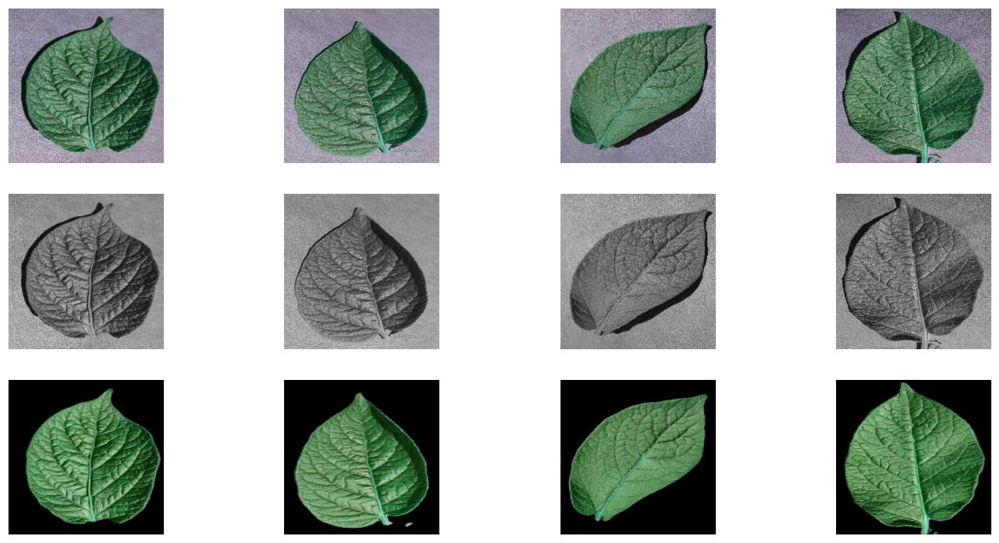

Papa - Tizón temprano


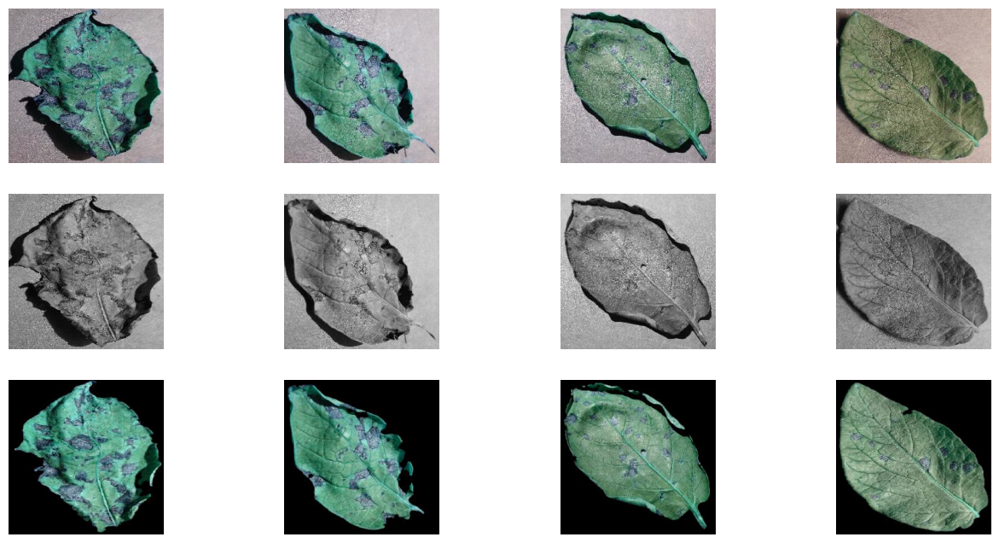

Papa - Tizón tardío


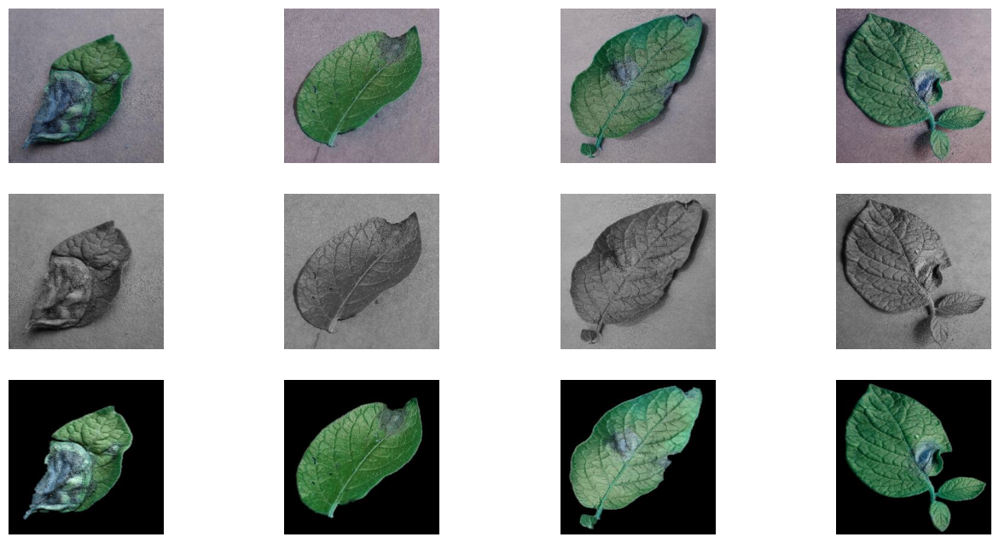

Frambuesa - Sano


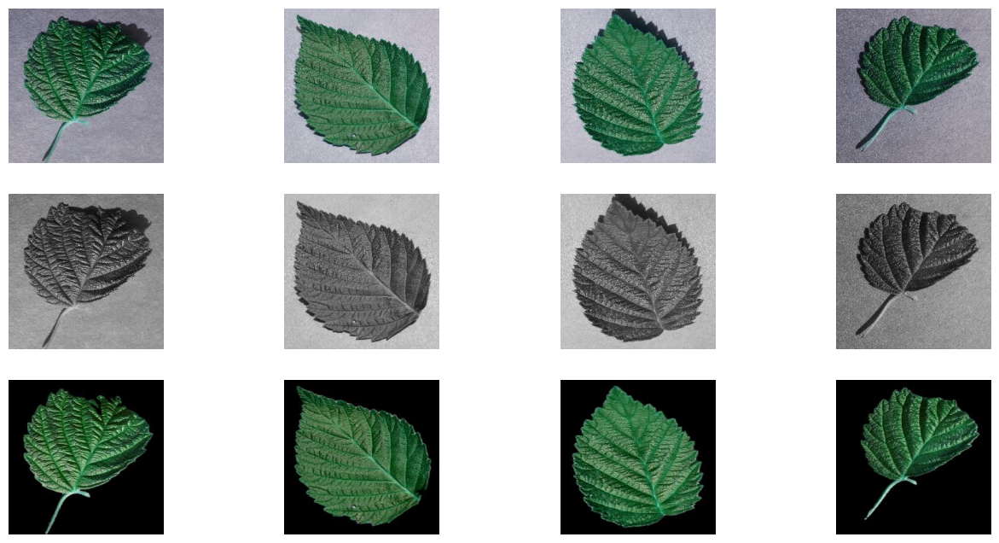

Soja - Sano


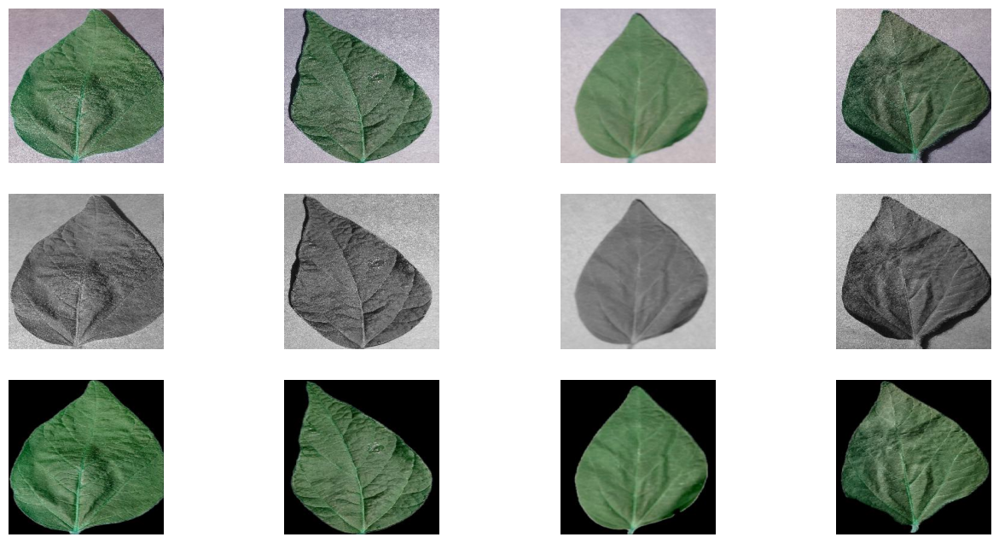

Calabaza - Oídio (cenicilla o polvillo blanco)


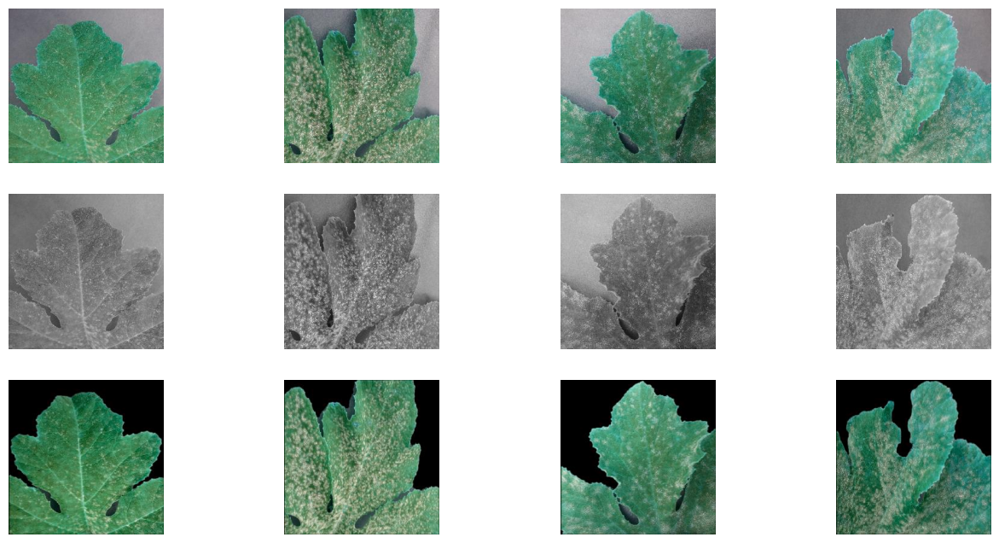

Fresa - Sano


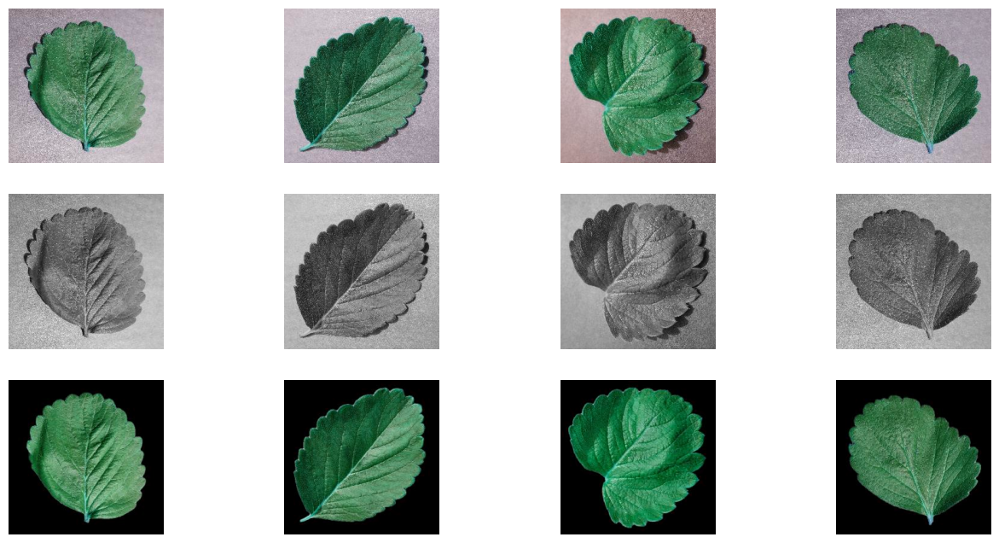

Fresa - Quemadura de la hoja


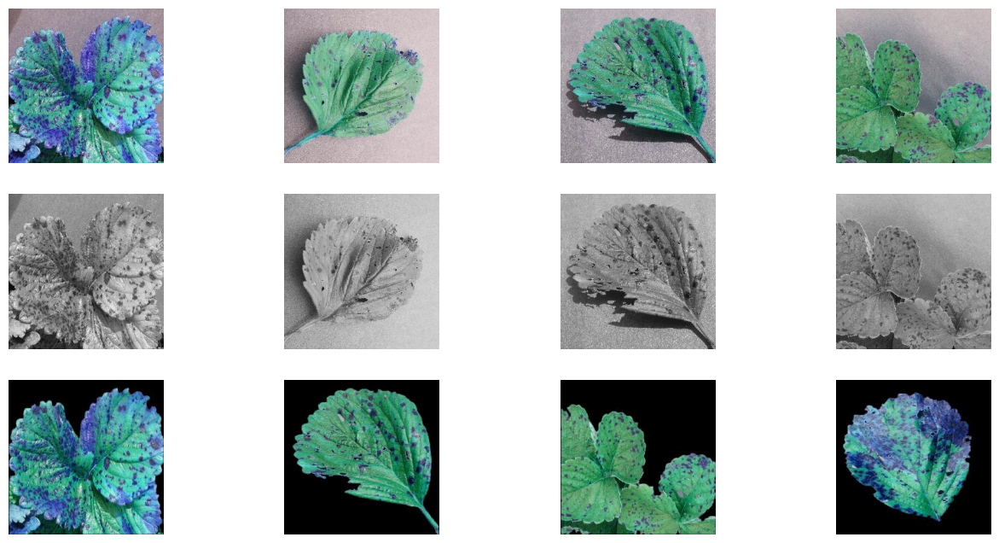

Tomate - Sano


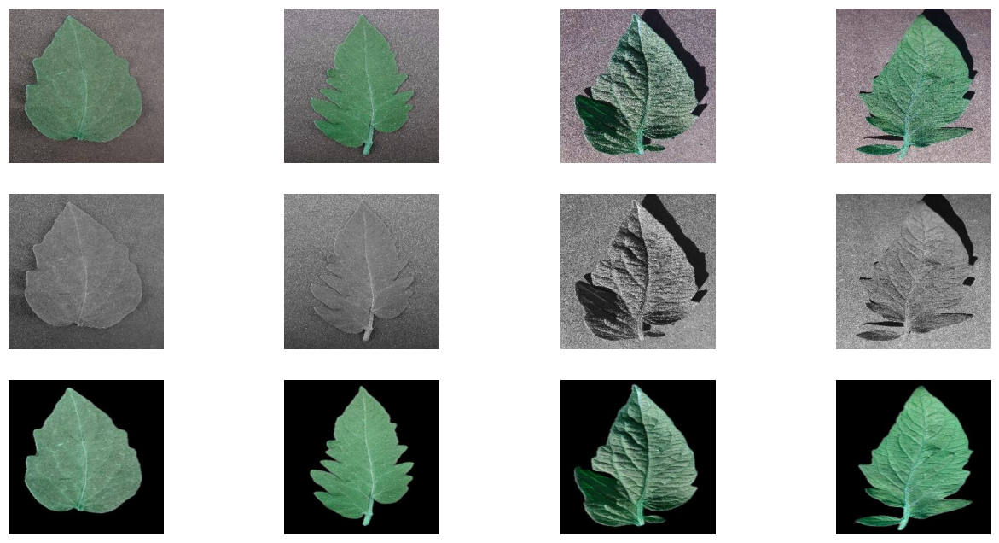

Tomate - Mancha diana


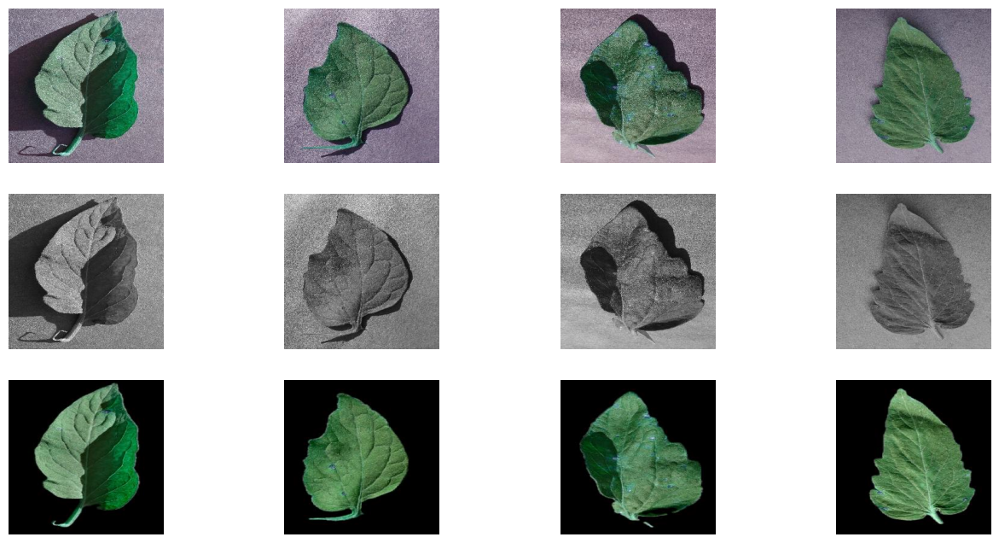

Tomate - Tizón tardío


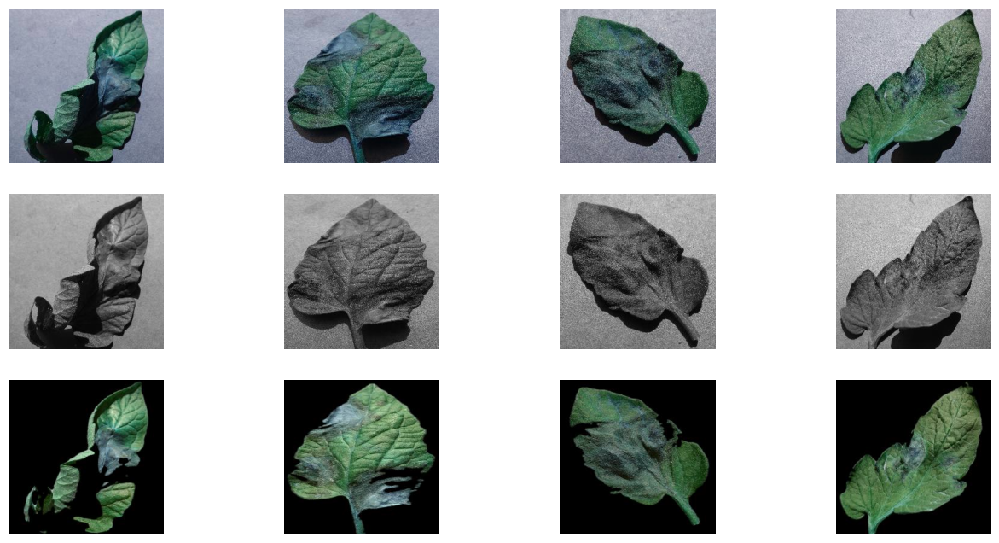

Tomate - Virus del mosaico


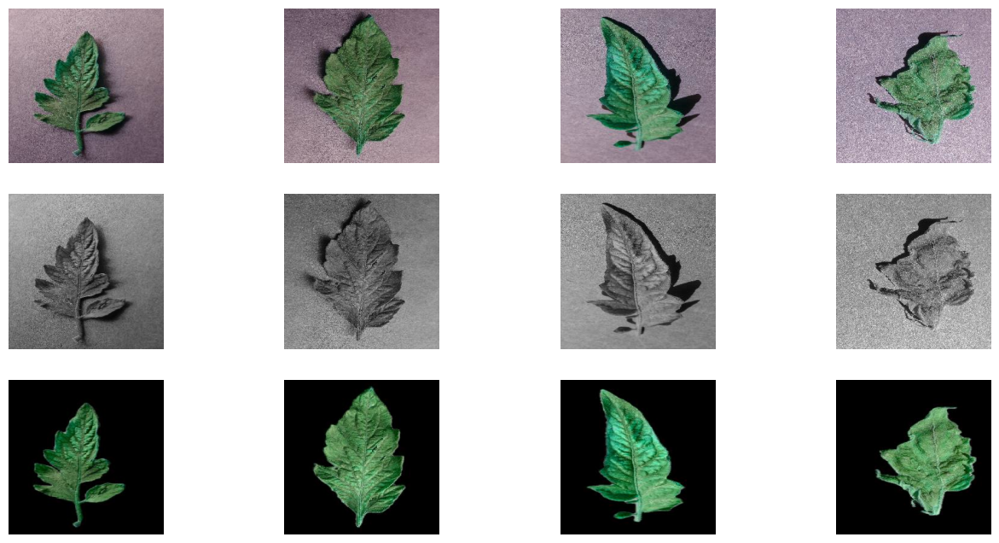

Tomate - Moho de la hoja


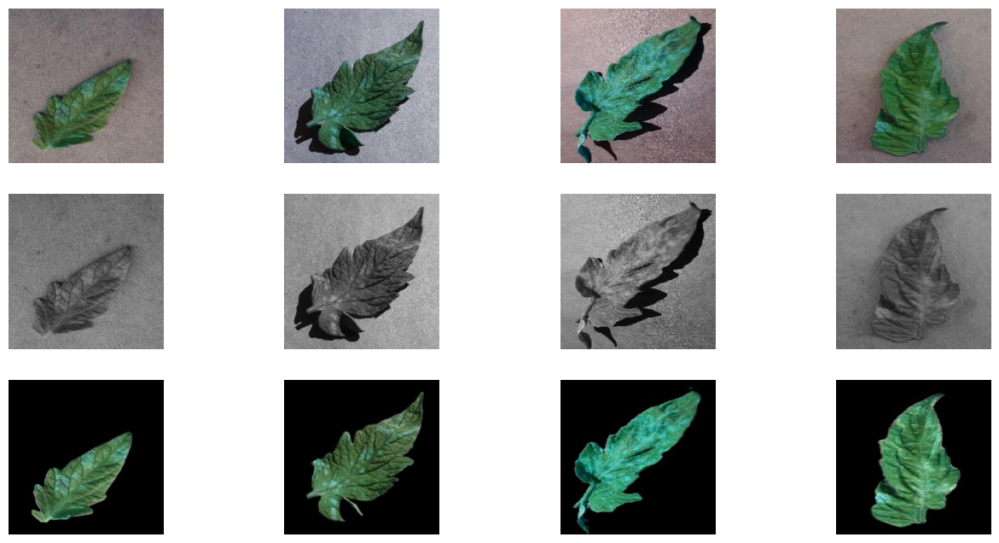

Tomate - Mancha bacteriana


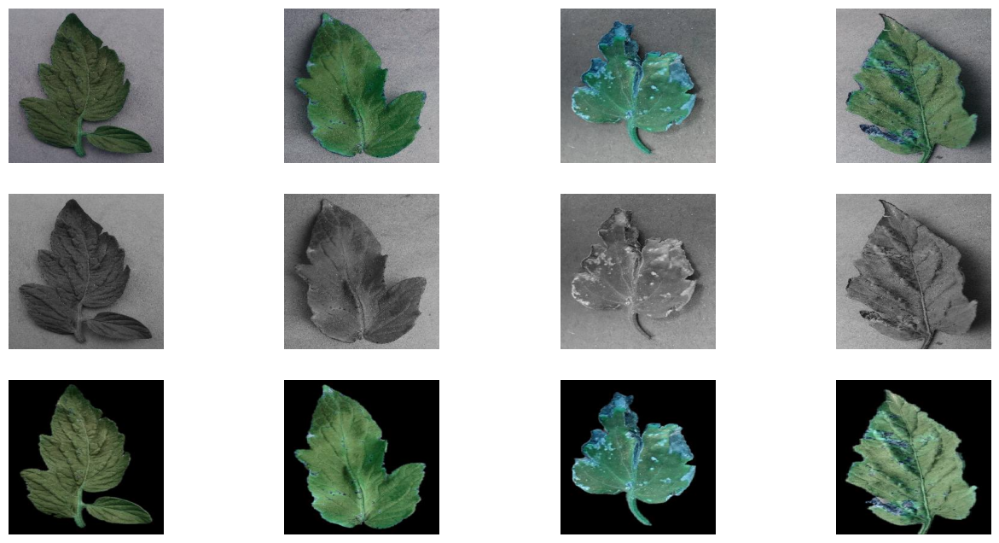

Tomate - Tizón temprano


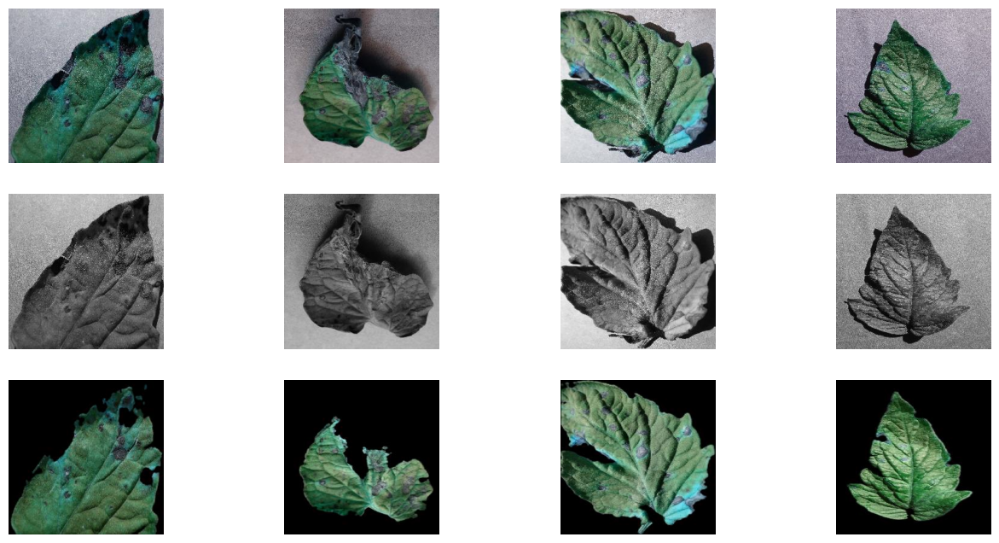

Tomate - Virus del rizado amarillo de la hoja


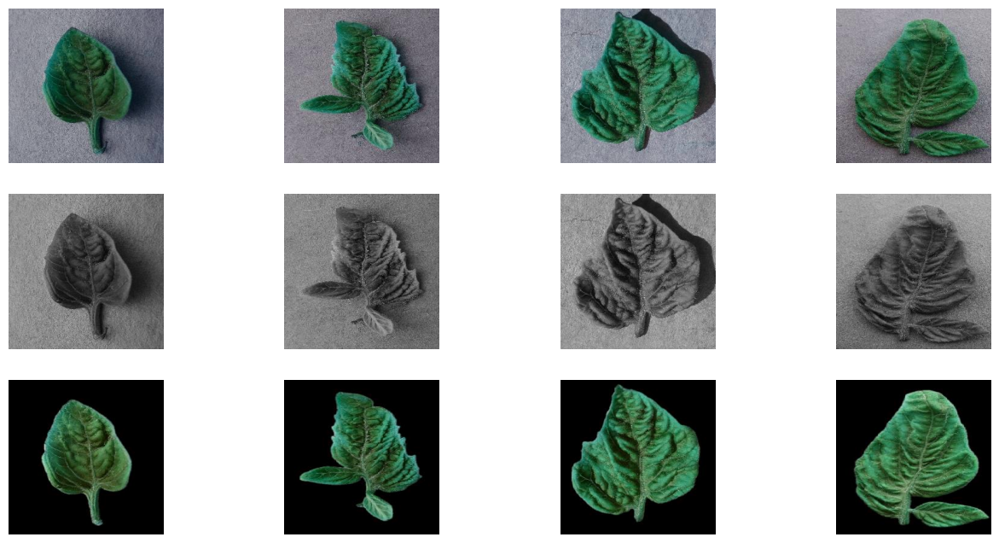

Tomate - Ácaros araña de dos manchas


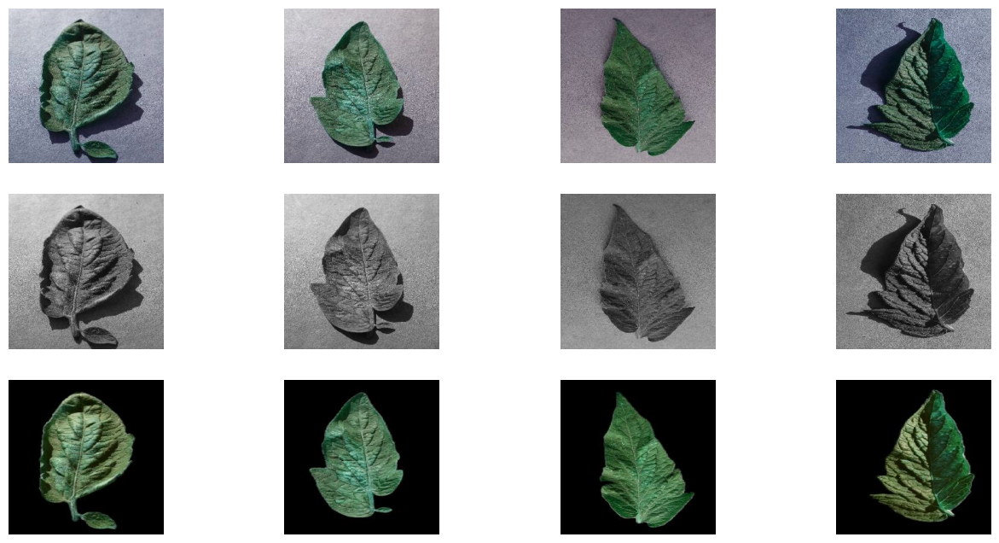

Tomate - Mancha foliar por septoria


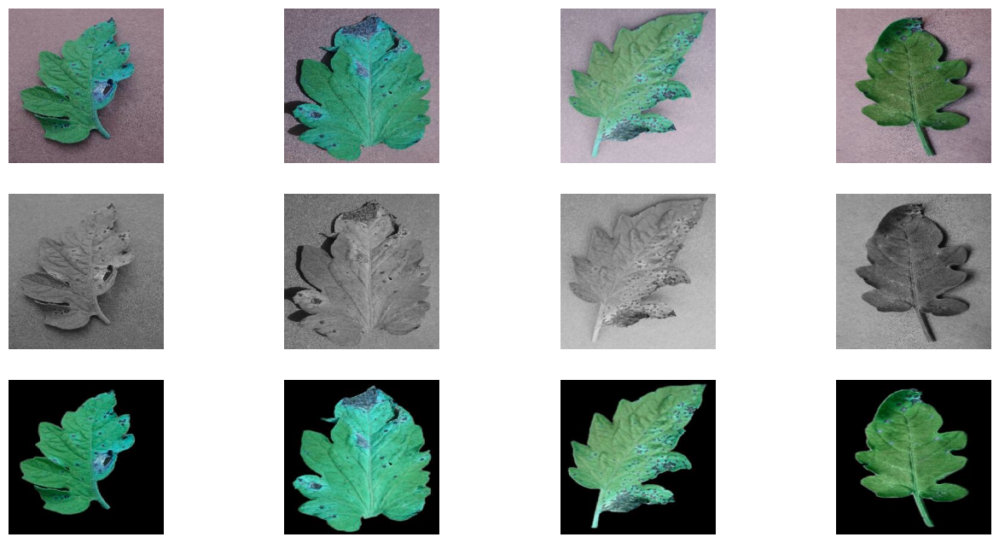

In [33]:
combinaciones = df[['Species', 'Disease', 'Healthy']].drop_duplicates()
combinaciones = combinaciones.sort_values(by=['Species', 'Healthy'], ascending=[True, False])

for _, row in combinaciones.iterrows():
    species = row['Species']
    # Determine the class name: 'disease_name' if diseased, 'healthy' otherwise
    disease = row['Disease'] if not row['Healthy'] else 'healthy'
    clase = f"{species}___{disease}"

    all_images = []

    for sub in subfolders:
        folder_path = os.path.join(base_dir, sub, clase)
        if not os.path.exists(folder_path):
            print(f"[AVISO] Carpeta no encontrada: {folder_path}")
            continue

        # Get the first 4 image files
        files = sorted([f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))])[:4]

        for file in files:
            img_path = os.path.join(folder_path, file)
            img = cv.imread(img_path)
            if img is None:
                print(f"[ADVERTENCIA] No se pudo cargar la imagen: {img_path}")
                continue
            img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
            all_images.append(img)

    if len(all_images) == 0:
        continue # Skip if no images were found for this combination

    if disease == 'healthy':
        main_title = f"{species_es_map.get(species)} - Sano"
    else:
        main_title = f"{species_es_map.get(species)} - {disease_es_map.get(disease)}"

    num_cols = min(len(all_images), 4)
    num_rows = (len(all_images) + num_cols - 1) // num_cols

    print(f"{main_title}")
    sv.utils.notebook.plot_images_grid(
        images=all_images,
        grid_size=(num_rows, num_cols),
        size=(16, 8),
    )

In [38]:
# Count the occurrences of each format
format_counts = df['Format'].value_counts()

print("Cantidad de imágenes por formato:")
print(format_counts)

Cantidad de imágenes por formato:
Format
segmented    54306
color        54305
grayscale    54305
Name: count, dtype: int64


Vemos que tenemos una imagen más en segmented que en el resto. Confirmemos que solo es un archivo y el resto son los mismos en los 3 formatos:

In [45]:
color_files = [f.lower() for f in df[df['Format'] == 'color']['FileName'].tolist()]
grayscale_files = [f.lower() for f in df[df['Format'] == 'grayscale']['FileName'].tolist()]

# Initialize list for processed segmented files
segmented_files_base = []

# Iterate through segmented rows to apply specific logic
for index, row in df[df['Format'] == 'segmented'].iterrows():
    file_name = row['FileName'].lower() # Get filename and convert to lowercase
    species = row['Species']
    disease = row['Disease']

    if species == 'Corn_(maize)' and disease == 'Common_rust_':
        # Specific rule: remove the UUID characters and then '_final_masked'
        base_name = file_name[39:].replace('_final_masked', '')
    else:
        # General rule: just remove '_final_masked'
        base_name = file_name.replace('_final_masked', '')

    segmented_files_base.append(base_name)

color_set = set(color_files)
grayscale_set = set(grayscale_files)
segmented_set = set(segmented_files_base)

files_unique_to_segmented = []

for file_name in segmented_set:
    if file_name not in grayscale_set or file_name not in color_set:
        files_unique_to_segmented.append(file_name)

print("\nArchivos (segmented) que no tienen contraparte en grayscale y color:")
for file in files_unique_to_segmented:
    print(f"- {file}")


Archivos (segmented) que no tienen contraparte en grayscale o color:
- com.g_spm_fl 1378.jpg
- rutg._bact.s 1526.jpg
- 42f083e2-272d-4f83-ad9a-573ee90e50ec___screen shot 2015-05-06 at 4.01.13 pm.jpg
- 7e1fd9b9-1fd9-4f98-93f5-8cf9ebc60dd9___fam_b.msls 4430.jpg
- d0badc95-d04c-457b-8db8-aa6e198f4bd6___ghlb leaf 10 day 6.jpg
- rs_l.scorch 1161.jpg
- rut._bact.s 3430.jpg


In [46]:
files_unique_to_color = []

for file_name in color_set:
    if file_name not in grayscale_set or file_name not in color_set:
        files_unique_to_color.append(file_name)

if len(files_unique_to_color) > 0:
    print("\nArchivos (color) que no tienen contraparte en grayscale y segmented:")
    for file in files_unique_to_color:
        print(f"- {file}")
else:
    print("Todos los archivos 'color' tienen una contraparte en 'grayscale' y 'segmented'.")

Todos los archivos 'color' tienen una contraparte en 'grayscale' y 'segmented'.


In [47]:
files_unique_to_grayscale = []

for file_name in grayscale_set:
    if file_name not in segmented_set or file_name not in color_set:
        files_unique_to_grayscale.append(file_name)

if len(files_unique_to_grayscale) > 0:
    print("\nArchivos (grayscale) que no tienen contraparte en color y segmented:")
    for file in files_unique_to_grayscale:
        print(f"- {file}")
else:
    print("Todos los archivos 'grayscale' tienen una contraparte en 'color' y 'segmented'.")


Archivos (grayscale) que no tienen contraparte en color y segmented:
- 42f083e2-272d-4f83-ad9a-573ee90e50ec___screen shot 2015-05-06 at 4.01.13 pm.png
- 8707fb49-a347-47a1-a60c-f96826d63a56___rutg._bact.s 1526.jpg
- 0db2da38-8650-461a-a785-814cc442f44d___com.g_spm_fl 1378.jpg
- 0112c6b2-72cd-402b-89cd-ca052983403e___rs_l.scorch 1161.jpg
- 29ba44c8-82f6-4841-b70c-1bcee8e3f5b9___rut._bact.s 3430.jpg
- d0badc95-d04c-457b-8db8-aa6e198f4bd6___ghlb leaf 10 day 6.jpeg


Quitando muy pocas excepciones, todas las imagenes las tenemos en los 3 formatos. Para los casos en que no, tampoco es un problema, a lo sumo por imágenes en las cuales podríamos aplicar los cambios necesarios para obtener los formatos faltantes.

Veamos si hay imágenes en otros formatos que no sean .jpg:

In [48]:
files_with_other_extensions = []

for root, dirs, files in os.walk(base_dir):
    for file in files:
        if not (file.endswith('.jpg') or file.endswith('.JPG')):
            files_with_other_extensions.append(file)

if files_with_other_extensions:
    print("Files not ending with .jpg or .JPG:")
    for f in files_with_other_extensions:
        print(f)
else:
    print("All files end with .jpg or .JPG")

Files not ending with .jpg or .JPG:
d0badc95-d04c-457b-8db8-aa6e198f4bd6___GHLB Leaf 10 Day 6.jpeg
42f083e2-272d-4f83-ad9a-573ee90e50ec___Screen Shot 2015-05-06 at 4.01.13 PM.png
d0badc95-d04c-457b-8db8-aa6e198f4bd6___GHLB Leaf 10 Day 6.jpeg
42f083e2-272d-4f83-ad9a-573ee90e50ec___Screen Shot 2015-05-06 at 4.01.13 PM.png


[Healthy] Avg. pixels used per image: 26859


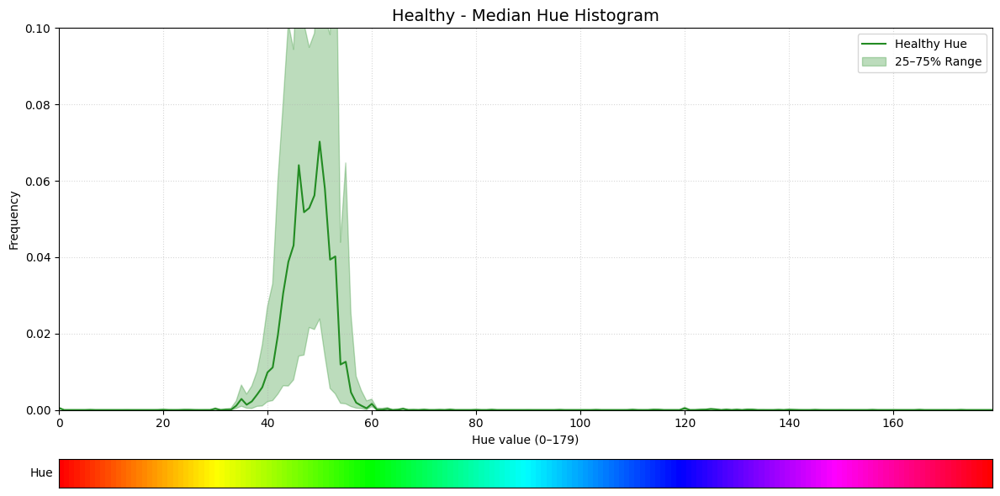

[Target_Spot] Avg. pixels used per image: 28539


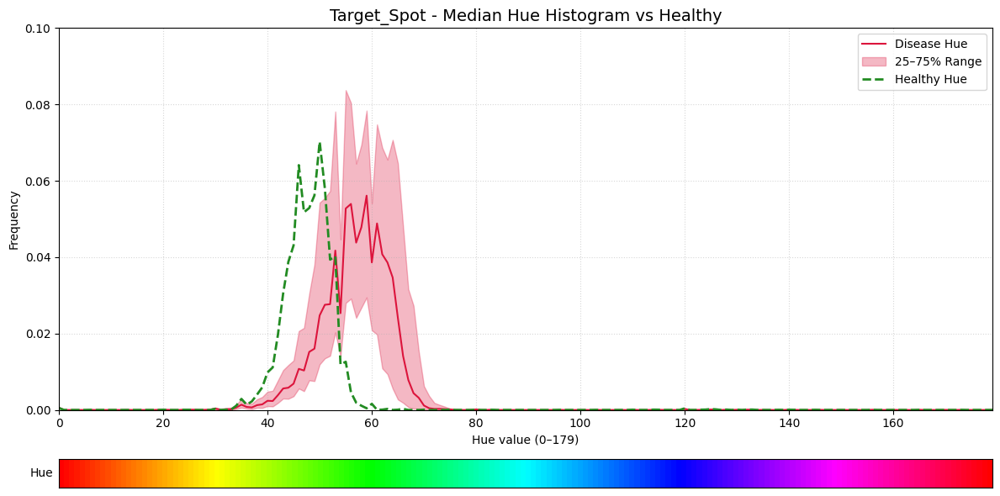

[Late_blight] Avg. pixels used per image: 22504


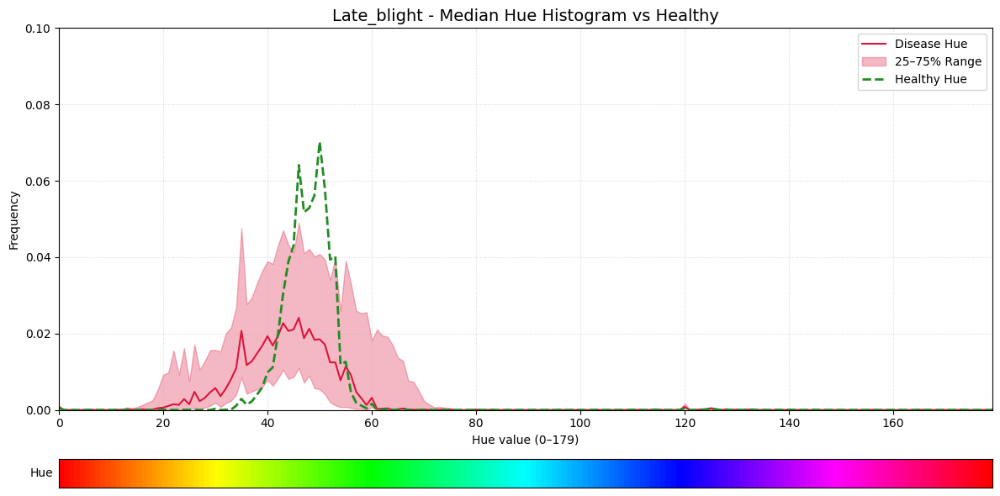

[Tomato_mosaic_virus] Avg. pixels used per image: 16968


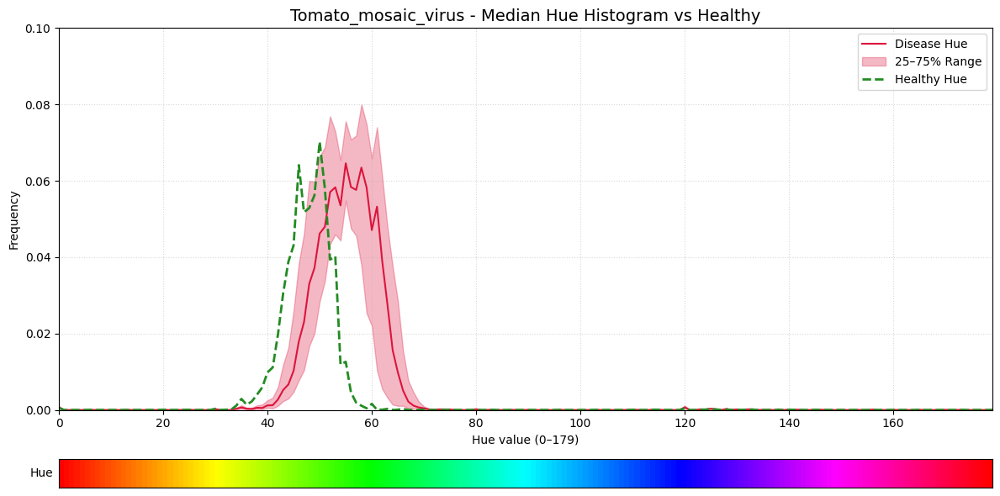

[Leaf_Mold] Avg. pixels used per image: 23797


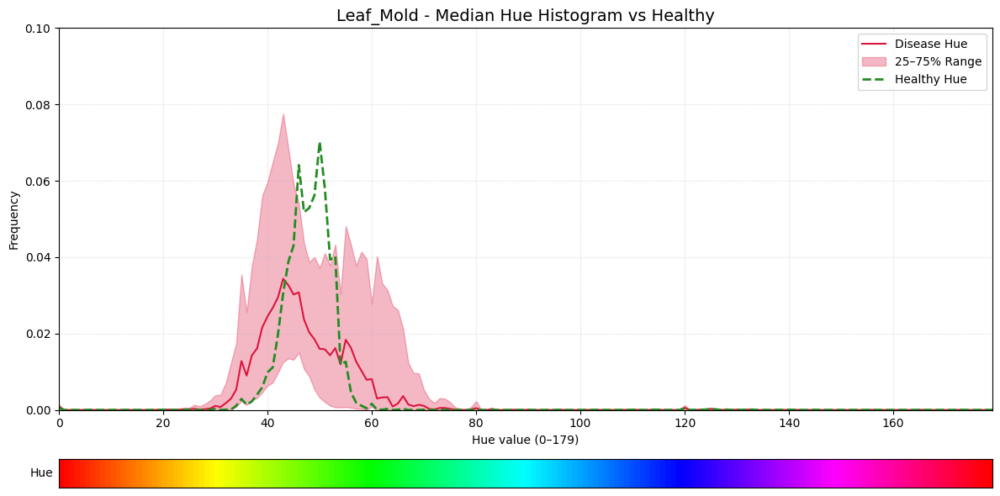

[Bacterial_spot] Avg. pixels used per image: 30957


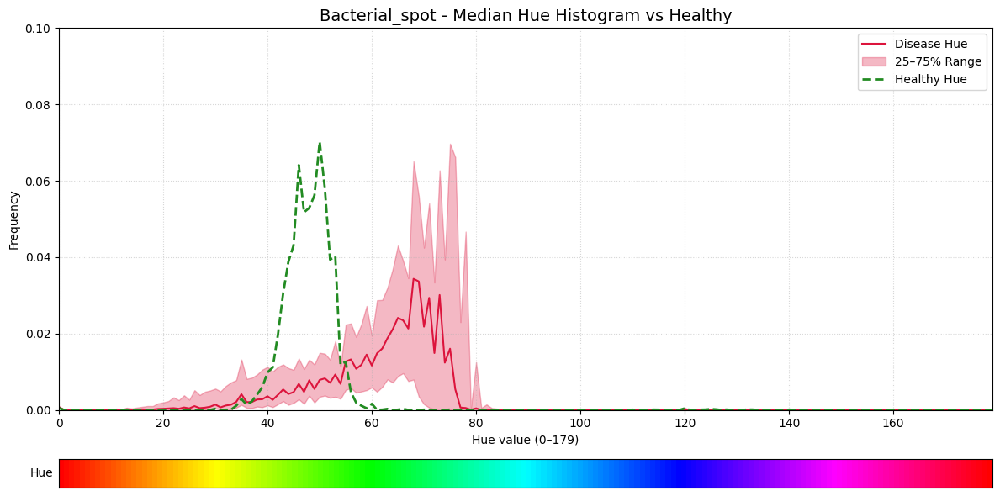

[Early_blight] Avg. pixels used per image: 26826


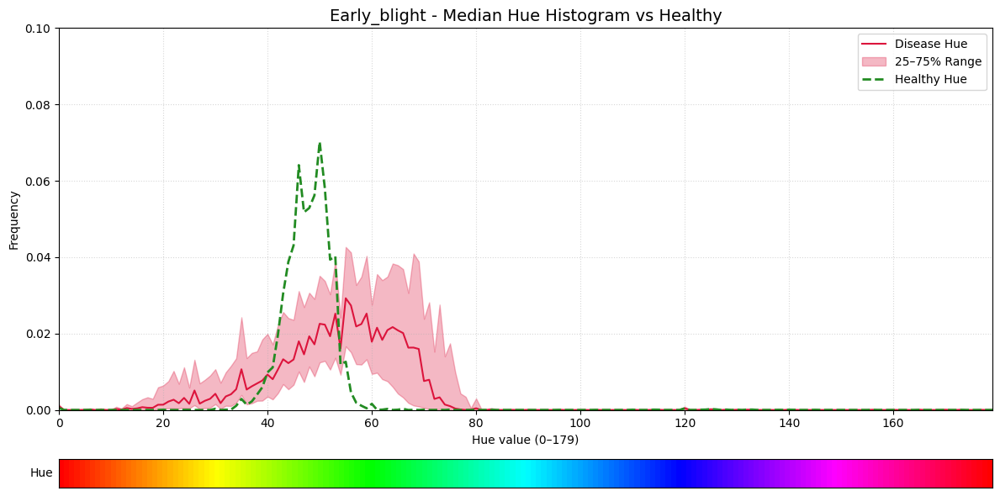

[Tomato_Yellow_Leaf_Curl_Virus] Avg. pixels used per image: 26551


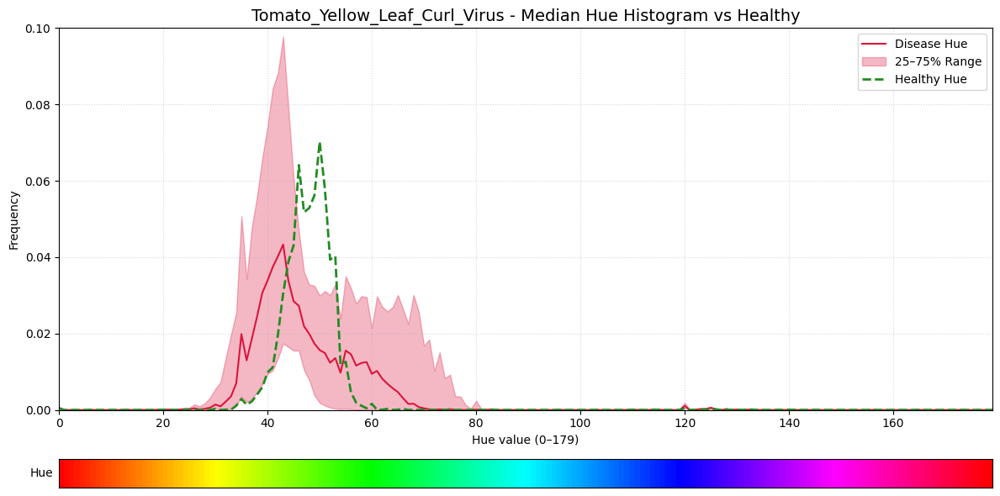

[Spider_mites Two-spotted_spider_mite] Avg. pixels used per image: 22384


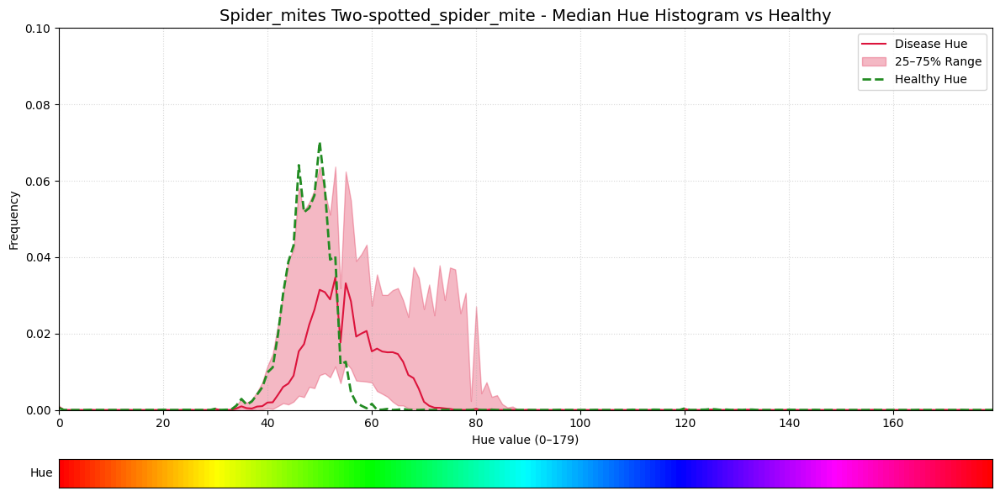

[Septoria_leaf_spot] Avg. pixels used per image: 25828


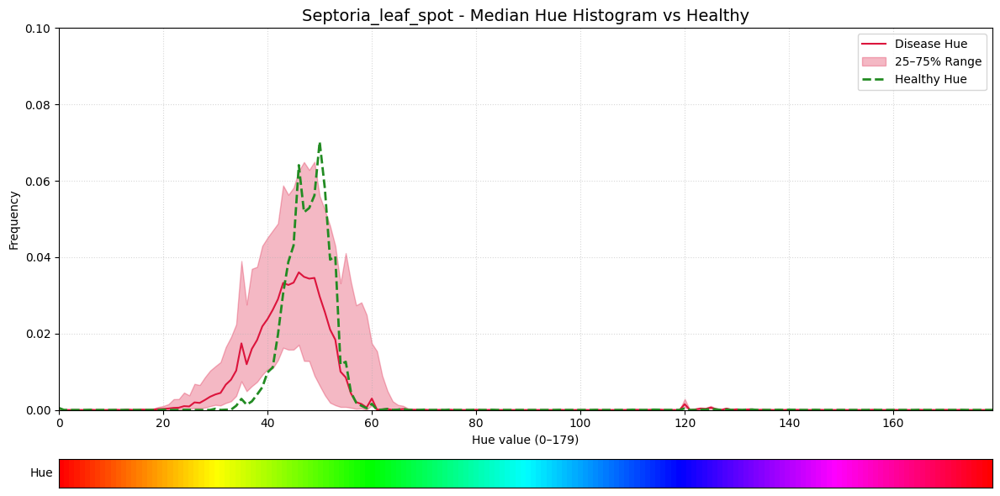

In [18]:
utils.print_hue_histograms()

## Conclusiones – Histogramas de Matiz (Hue) Mediana

- Las hojas **sanas** presentan un rango de matiz (hue) bastante acotado, concentrado entre 40 y 60, asociado al color verde típico.
- Las enfermedades (Target_Spot, Late_blight, Tomato_mosaic_virus, Leaf_Mold, Bacterial_spot) desplazan la distribución del matiz hacia valores mayores, mostrando picos más altos y colas extendidas hacia la derecha.
- Hay **diferenciación clara** entre las distribuciones de hojas sanas y enfermas: las enfermas tienden a ser menos verdes y muestran más variabilidad cromática.
- Este patrón sugiere que el matiz mediano es un **buen descriptor para distinguir entre hojas sanas y enfermas**, aunque existe solapamiento entre clases.
- La separación es más marcada en algunas enfermedades (ejemplo: Bacterial_spot), lo que podría facilitar su detección visual o automática.
